# Biology Schedule Processing

## Purpose & Rationale

Many scheduling tasks benefit from a comprehensive view of past teaching. However, it can be challenging to understand this by clicking through individual pages on the UW Bothell web site. This script automates the process. 

The script produces a summary `master_schedule.csv` file that can be opened in Excel and is useful for finding which classes have been taught by which instructors, what each class number means, etc. **However, because the format of web reports can be inconsistent, all summarized data should be manually cross-checked before being used for critical tasks**. If you notice any problems, please submit a GitHub issue.


## Set up code for parsing class schedules

Class schedules are listed openly online, but the format is not very consistent, so it takes a significant amount of work to collect all the data into a spreadsheet.

In [78]:
import pandas as pd
class ClassSection(object):
    def __init__(self,text,current_class="-",class_number="-"):
        
        self.ExpectedFields = ['Class','Restrictions','Add Code Required','SLN', 'ID', 'Credit', 'Laboratory','Meeting Day', 
                           'Meeting Times','Building','Room', 'Instructor', 'Status', 'Enrolled', 
                            'Enrollment Limit','Grades','Fee','Other']
        
        self.Class = current_class
        self.Text = self.preprocess_text(text)
        self.Fields = self.extract_fields()
        self.Fields = self.postprocess_fields()
        self.ExpectedFields.insert(0,"Class Number")
        self.Fields.insert(0,class_number) 
        
    def postprocess_fields(self):
        """Postprocess fields"""
        print("Postprocessing fields...")
        new_fields = []
        for i,field in enumerate(self.Fields):
            label = self.ExpectedFields[i]
            if label == "Instructor":
                print(">"*40)
                print(f"Postprocessing name: {field}")
                #Should capitalize these better
                if not "," in field:
                    #Probably a placeholder like "-"
                    #append 'as is'
                    new_fields.append(field)
                    continue
                
                field = field.replace(",",", ")
                field = field.title()
              

                new_words = []
                for i,word in enumerate(field.split()):
                    word = word[0].upper()+word[1:] 
                    print("word:",word)
                    #Capitalize after Mc, as in McNabb
                    if word.startswith("Mc") and len(word) > 2:
                        word = "Mc"+word[2:].title()
                        
                    if (word.startswith("al-") or word.startswith("AL-")) and i > 0:
                        #Arabic names with 'al-' are only capitalized at
                        #the start of a name 
                        pre,post = word.split("-")
                        pre = pre.lower()
                        post = post.title()
                        word = "-".join([pre,post])
                    new_words.append(word)
                field = " ".join(new_words)
                
                print(f"Postprocessed name: {field}")
                print(">"*40)
            
            new_fields.append(field)
        return new_fields
            
    
    
    
    def extract_fields(self):
        """Extract fields from self.Text"""
        self.Fields = [self.Class]
        
        self.Fields.extend(self.Text.split())
        print("STARTING FIELDS:",self.Fields)
        
        self.Fields = self.collapse_name_fields()
        
        print("*"*80)
        expected_fields = self.ExpectedFields
        result = {}
        
        fields = self.Fields
        skip_next_field = False
        for i,field_text in enumerate(fields): 
            
                
            if skip_next_field:
                print(f"Already assigned {field_text}...skipping")
                skip_next_field = False
                continue
                
            if "Restr" in field_text:
                print("Text Restr only shows up in restrictions field")
                result["Restrictions"] = field_text
                fields.remove("Restr")
                continue
            
            found_valid_field = False
            skip = 0
            
            while not found_valid_field: 
                
                #Check we haven't reached the end
                if i+skip >= len(expected_fields):
                    #Just add this to other
                    print("Hit end of fields, just adding this field to Other.")
                    result["Other"] = result.get("Other","") + f" Note: couldn't interpret '{field_text}', in original."
                    break
                    
                putative_field = expected_fields[i+skip]
                if result.get(putative_field,None) is not None:
                    print(result)
                    print(f"Already have an entry for {putative_field}...{field_text} must be for the next field.")
                    skip += 1
                    continue
                    
                if self.validate(putative_field,field_text):
                    result[putative_field] = field_text
                    found_valid_field = True
                    
                    #Special case for multiword instructor name like Horn,Teresa Marie
                    if putative_field == "Instructor":
                        next_entry = fields[i+1]
                        print(f"Checking if {next_entry} might be part of instructor name {field_text}")
                        if next_entry not in ["Open","Closed"]:
                            if next_entry.istitle() or next_entry.isupper() or self.validate("Instructor",next_entry):
                                print("It is! Adding to name")
                                result[putative_field] += " "+next_entry
                                #We already found the next field was a name, so skip the next field
                                skip_next_field=True
                    print(f'Validated field {i}, "{field_text}" as {putative_field}')
                else:
                    #If invalid, maybe this is really the next field?
                    #fill this one in as missing and move on
                    print(f"{field_text} ({i}) DID NOT validate as {putative_field}. Maybe this field was skipped and it is really {expected_fields[i+skip+1]}?")
                    result[putative_field] = "-"
                    skip += 1
        print(f"Result:{result}")       
        self.Fields = [result.get(expected_field,"-") for i,expected_field in enumerate(self.ExpectedFields)]
        return self.Fields
    
    def collapse_name_fields(self,before_name_field="Room",after_name_field="Status"):
        """Returns a collapsed version of multi-part names. 
        
        This helps avoid issues since names are not quoted, nor are columns delimited consistently."""
        fields = self.Fields
        end_index=len(fields)
        begin_index = 0
        
        
        for i,field_text in enumerate(fields):
            #print(f"On index {i}/{len(fields)}")
            if i+1 >= len(fields):
                print("Didn't find status field but at end of fields, aborting")
                return fields
                
            if self.validate(before_name_field,field_text) and not self.validate(before_name_field,fields[i+1]):
                #print("Found Room field:",field_text)
                begin_index = i+1
                continue
            
            if self.validate(after_name_field,field_text):
                end_index = i-1
                #print("Found Status field",field_text)
                break
        
        #If there's only one field between Rooom and Status,
        #it must be the name. All is well and no change is needed
        if begin_index == end_index:
            print("Just one name field, no need to collapse")
            return fields
        
        if end_index == len(fields):
            #Couldn't find reasonable end point, might be missing normal fields like status???
            #Just guess normal position of name
            
            best_guess_name_field = 11
            if self.validate("Instructor",fields[best_guess_name_field]):
                print(f"Might be missing status? Just guessing that field {best_guess_name_field} ('{fields[best_guess_name_field]}') holds a name.")
                return fields[best_guess_name_field]
            
            
        print("First name field:",begin_index)
        print("Last name field:",end_index)
        new_fields = [f for f in fields[0:begin_index]]
        new_fields.append("_".join(fields[begin_index:end_index]))
        print("Collapsed name field:",new_fields[-1])
        final_fields = fields[end_index:]
        new_fields.extend(final_fields)
        return new_fields
            
    def validate(self,field_name,text):
        """Validate field names
        
        Since the number of fields isn't consistent, we have to guess which data goes with which column. It's relatively
        easy by eye, but hard for code. This code tests whether an entry *could be* a name, SLN, time, etc 
        to try to sort out the proper order.
        
        Field names are: 'Class','Restrictions','Add Code Required','SLN', 'ID', 'Credit', 'Laboratory,'Meeting Day', 
                           'Meeting Times','Building','Room', 'Instructor', 'Status', 'Enrolled', 
                            'Enrollment Limit','Grades','Fee','Other']
        
        """
        field_name = field_name.strip()
        if field_name == "Class":
            if text.isupper() and len(text) > 5:
                return True
            
            return False
        if field_name == "Restrictions":
            #Valid entries are independent_study or add_code_required
            valid_entries = ["no_restriction","independent_study","restr"]
            if text.strip() in valid_entries:
                return True
            else:
                return False
        
        if field_name == "Instructor":
            
            #Should have the form Galindo,Heather
            if "," in text:
                return True
            
            forbidden_names = ["UWBB","DISC","SSG CNSVTRY"]
            for f in forbidden_names:
                if f in text:
                    return False
                
            #Names should be alphabetical
            try:
                if not text.alpha():
                    return False
            except:
                if not text.isalpha():
                    return False
            
            if text.istitle() or text.isupper() or text.islower():
                return True
            
            return False
        
        if field_name == 'Add Code Required':
            if text == 'add_code_required':
                return True
            if text == 'no_add_code':
                return True
            return False
        
        if field_name == "Building":
            if text == "*":
                #Used for online classes
                return True
            if "," in text:
                return False
            if not text.isupper():
                return False
            
        if field_name == "Room":
            
            #Could be an online class
            if text == "*":
                return True
            try:
                text = int(text)
                return True
            except ValueError:
                #Could be combo like "107G"
                if text[0:-1].isdigit() and text[-1].isalpha():
                    return True
                
                if text == "CNSVTRY":
                    #Conservatory
                    return True
                #If not this is something else
                return False
        
        
        if field_name == "SLN":
            try:
                int(text)
                return True
            except ValueError:
                return False
            
        if field_name == "ID":
            if len(text) <= 3 and text.isupper():
                return True
            else:
                return False
        
        if field_name == "Credit":
            
            
            if "-" in text:
                min_credit,n_credit = text.split("-")
                n_credit = int(n_credit)
                if int(min_credit) != 1:
                    return False
            else:
                try:
                    n_credit = int(text)
                except ValueError:
                    return False
            
            if n_credit >= 10:
                return False
            
            return True
            
        if field_name == "Laboratory":
            #If it's a lab or studio with a code like LB or ST,
            #it's a good entry for the credit column
            
            if text in ["CK","CL","CO","IS","LB","LC","PR","QZ","SM","ST"]:
                return True
            
            return False
            
        if field_name == "Grades":
            if "CR_NC" in text or "CR/NC" in text or "conventional" in text:
                return True
            else:
                return False
            
        if field_name == "Fee":
            if "$" in text:
                return True
            else:
                return False
            
        if field_name == "Meeting Day":
            valid_days = ["M","T","W","Th","F"]
            found_valid_first_day = False
            for v in valid_days:
                if text.startswith(v):
                    found_valid_first_day = True
            if not found_valid_first_day:
                return False
            
            found_valid_last_day = False
            for v in valid_days:
                if text.endswith(v):
                    found_valid_last_day = True
            if not found_valid_last_day:
                return False
            
            if found_valid_first_day and found_valid_last_day:
                return True
            
        if field_name == "Meeting Times":
            
            if "to be arranged" in text or "to_be_arranged" in text:
                return True
            
            if not "-" in text:
                return False
            start,end = text.split("-")
            if len(start) > 4:
                return False
            if len(end) > 4:
                return False
            
            #Ignore the p in 5:45-7:45P
            if text.endswith("P") or text.endswith("p"):
                text = text[:-1]
            try:
                start = int(start)
                end = int(end)
                
                if start > 2400 or end >2400:
                    return False
                
            except ValueError:
                return False
            
            return True
        
        if field_name == "Enrolled" or field_name == "Enrollment Limit":
            try:
                text = int(text)
            except ValueError:
                return False
            
            max_plausible_enrollment = 1000
            if text > max_plausible_enrollment:
                return False
            else:
                return True
            
        if field_name == "Status":
            if text in ["Open","Closed"]:
                return True
            else:
                return False
            
        if field_name == "Other":
            #One letter codes:
            if text.upper() and len(text): 
                return True
        print(f"No checks done on field '{field_name}'")
            
        return True
        
    def preprocess_text(self,text):
        """Preprocess text to remove inconsistent formatting"""
        text = text.replace("\r","")
        text = text.replace("to be arranged","to_be_arranged")
        text = text.replace("CR/NC","CR_NC")
        text = text.replace("/ "," ")
        text = text.replace("IS\w>","independent_study add_code_required ")
        text = text.replace(">","add_code_required ")
        text = text.replace(" IS "," independent_study ")
        text = text.lstrip()
        text = text.strip()
        
        #Annoyingly, restrictions field is left blank if there are no restrictions
        #So we have to fill in blanks
    
        restricted = False
        restriction_codes = ["add_code_required ","independent_study","independent_study add_code_required "]
        for r in restriction_codes:
            if r in text:
                print("Already restricted!")
                restricted = True
        
        if restricted == False:
            text = " ".join(["no_restriction no_add_code",text.lstrip()])
            
        return text

## Define functions for scraping the schedule from the UW Bothell website

In [79]:
#NOTE: BeautifulSoup comes with Anaconda Python

import requests
from bs4 import BeautifulSoup
from collections import defaultdict

#Example website for a division
#fall_schedule_website = "https://www.washington.edu/students/timeschd/B/AUT2024/bbio.html"
#fall_schedule_page = requests.get(fall_schedule_website)


def scrape_schedule(quarter,year,division_shorthand="bbio"):
    """Return a pandas dataframe of the schedule for a given quarter and year
    
    quarter - "AUT","WIN","SPR"
    year - four digit year 2024 etc
    division_shorthand - abbreviation for division e.g. "bbio"
    """
    schedule_page = quarter + str(year)
    web_address = f"https://www.washington.edu/students/timeschd/B/{schedule_page}/{division_shorthand}.html"
    print(f"About to scrape {division_shorthand} schedule for {quarter} {year} from:\n {web_address}")
    schedule_page = requests.get(web_address)
    results_df = extract_class_info(schedule_page,division_shorthand)
    return results_df

    
def extract_class_info(page,division_shorthand):
    """From a UW Bothell schedule page, extract schedule information"""        
    
    results = defaultdict(list)
    
    soup = BeautifulSoup(page.content,"html.parser")
    
    #Schedule web page is formatted as non-nested tables
    #In other words, the header for a class is a separate HTML table from 
    #the actual info on sections of a class. So we have to iterate over tables
    #and keep track of which class we're in.
    
    tables = soup.find_all("table")
    current_class = None
    current_class_number = None
    header_dict = {}
    for t in tables:
        table_headers = t.find_all("a",href=True)
        
        #Class headers are the only rows with e.g. bbio.html in them
        for i,h in enumerate(table_headers):
            
           
                
            if f"{division_shorthand}.html" in h.prettify():
                full_header = str(h)
                class_number = full_header.split("#")[1].split('"')[0]
                class_number = class_number.upper()
                print("Class number:",class_number)
                current_class = h.text
                print(f"Processing schedule for class: {current_class}")
        
            
        unscheduled_classes = ["IND STUDY BIOL","UG RESEARCH BIOL"]
        unscheduled = False
        for c in unscheduled_classes:
            if current_class and c in current_class:
                unscheduled = True
        if unscheduled:
            print(f"Skipping class {current_class} ... it has no scheduled meeting time")
            continue
        #Instructors are *also* tables
        #but always use preformatted text style
        preformatted_text_rows = t.find_all("pre")
        
        
        for r in preformatted_text_rows:
            text = r.text
            if text.startswith("Enrl"):
                header_dict = parse_header_line(text,use_hardcoded=True)
                continue
            
            #print(f"Parsing row text: {text}")
            unscheduled_classes = ["IND STUDY BIOL","UG RESEARCH BIOL"]
            unscheduled = False
            for c in unscheduled_classes:
                if current_class and c in current_class:
                    unscheduled = True
            if unscheduled:
                print(f"Skipping class {current_class} ... it has no scheduled meeting time")
                continue
                
            if "RESERVE" in text:
                print("Reserved section not yet filled ... skipping")
                continue
            #The logic for parsing an intructor entry is sort of annoying since empty entries aren't marked
            #but just skipped, resulting in rows with 8-14 fields, depending. 
            #We'll handle parsing these rows in another function
            fields = parse_section_entry(text,header_dict,current_class=current_class,class_number=class_number)
            print("FINAL FIELDS:",fields)
            #Now add data from this class to lists
            #in our column dict, which will become columns
            #in the output data sheet
            for i,text in enumerate(fields):
                label = header_dict[i]
                print(f"{label} = {text}")
        
                #Grow columns of data in results
                #dict
                results[label].append(text)
                
            
    print(results)
    #Check results to see if any columns are off
    print("CHECK RESULTS")
    for k in results.keys():
        print(k,results[k],len(results[k]))
    results_df = pd.DataFrame(results,columns = [header_dict[i] for i in range(len(header_dict))])
    return results_df

def parse_header_line(text,use_hardcoded=True):
    """Return a dict mapping column indices to column names
    
    use_hardcoded -- ignore actual header line and use a hardcoded alternative
    """
    newline_count = text.count("\n")
    header_rows = text.split("\n")
    best_header_dict = {}
    for row_text in header_rows:
        #Split out header fields combined with a slash (eg. bldg/room or enrl/max)
        row_text = row_text.replace("/"," ")
        header_fields = row_text.split()
        curr_header_dict = {i:colname for i,colname in enumerate(header_fields)}
        if len(curr_header_dict) > len(best_header_dict):
            best_header_dict = curr_header_dict
            
    if use_hardcoded:
        best_header_dict = {0: 'Class Number',
                            1: 'Class',
                            2: 'Restrictions',
                            3: 'Add Code Required',
                            4: 'SLN', 
                            5: 'ID', 
                            6: 'Credit', 
                            7: 'Laboratory',
                            8: 'Meeting Day', 
                            9: 'Meeting Times',
                            10: 'Building',
                            11: 'Room', 
                            12: 'Instructor', 
                            13: 'Status', 
                            14: 'Enrolled', 
                            15: 'Enrollment Limit', 
                            16: 'Grades',\
                            17: 'Fee', 
                            18: 'Other'}
    return best_header_dict
    
def parse_section_entry(row_text,header_dict,n_expected_fields=16,current_class=None,class_number=None):
    """Return a list of exactly fields for instructor row
    
    Note: entries can have more than one row
    if they include notes. These are separated by <br> elements
    within the preformatted block
    """
    
    row_text = row_text.strip()
    print("-"*80)
    br_count = row_text.count("<br>")
    #print(f"<br> elements: {br_count}")
    
    newline_count = row_text.count("\n")
    #print(f"\\n elements: {newline_count}")
    
    if newline_count:
        class_lines = row_text.split("\n")
        row_text = class_lines[0] 
        comment_text = "\n".join(class_lines[1:])
    
    
    print(row_text)
    fields = [current_class]
    fields.extend(row_text.split())
    
    print(f"ORIGINAL ROW (length {len(fields)}): {fields}")
    #Substitute funky characters that prevent us from processing row fields
    text = row_text
    
    
    
    
    section = ClassSection(text,current_class=current_class,class_number=class_number)
    
    return section.Fields

## Compile an overall schedule 

In [80]:
overall_csv = None

from os import mkdir
from os.path import join,exists
next_quarter = "AUT"
current_year = 2024

for division in ['BST','BBIO','BDATA','BCORE','BEARTH','BCHEM','CSS']:
    for year in range(2016,2025):
        for quarter in ["AUT","WIN","SPR","SUM"]:
            #quarter = "AUT"
            #year = 2024
            quarter_to_number = {"WIN":"1","SPR":"2","SUM":"3","AUT":"4"}
            quarter_number = quarter_to_number[quarter]
            if year == current_year and quarter_number > quarter_to_number[next_quarter]:
                print(f"No data available for {division} {year}, {quarter} - more than one quarter into the future")
                continue
            schedule_dir = f"../schedules/{division.lower()}_schedules"
            if not exists(schedule_dir):
                mkdir(schedule_dir)
            results_df = scrape_schedule(quarter,year,division.lower())
            
            
            results_file = f"{year}_{quarter}_{division}.csv"
            results_filepath = join(schedule_dir,results_file)
            if results_df.shape[0] >5:
                results_df.insert(2,"Division",division)
                results_df.insert(3,"Year",year)
                results_df.insert(4,"Quarter",quarter)
            
            results_df.to_csv(results_filepath,index=False)
        

About to scrape bst schedule for AUT 2016 from:
 https://www.washington.edu/students/timeschd/B/AUT2016/bst.html
Class number: BST200
Processing schedule for class: INTRO TO CLIMATE SCI
--------------------------------------------------------------------------------
11885 A  5       TTh    845-1045   LBA  003      GALINDO,HEATHER MICHELLE   Open     29/  30
ORIGINAL ROW (length 13): ['INTRO TO CLIMATE SCI', '11885', 'A', '5', 'TTh', '845-1045', 'LBA', '003', 'GALINDO,HEATHER', 'MICHELLE', 'Open', '29/', '30']
STARTING FIELDS: ['INTRO TO CLIMATE SCI', 'no_restriction', 'no_add_code', '11885', 'A', '5', 'TTh', '845-1045', 'LBA', '003', 'GALINDO,HEATHER', 'MICHELLE', 'Open', '29', '30']
First name field: 10
Last name field: 11
Collapsed name field: GALINDO,HEATHER
********************************************************************************
Validated field 0, "INTRO TO CLIMATE SCI" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code

About to scrape bst schedule for SUM 2016 from:
 https://www.washington.edu/students/timeschd/B/SUM2016/bst.html
Class number: BST200
Processing schedule for class: INTRO TO CLIMATE SCI
--------------------------------------------------------------------------------
14352 A  5       MW     1230-230   SSG  CNSVTRY  GALINDO,HEATHER MICHELLE   Open     15/  30                      
ORIGINAL ROW (length 13): ['INTRO TO CLIMATE SCI', '14352', 'A', '5', 'MW', '1230-230', 'SSG', 'CNSVTRY', 'GALINDO,HEATHER', 'MICHELLE', 'Open', '15/', '30']
STARTING FIELDS: ['INTRO TO CLIMATE SCI', 'no_restriction', 'no_add_code', '14352', 'A', '5', 'MW', '1230-230', 'SSG', 'CNSVTRY', 'GALINDO,HEATHER', 'MICHELLE', 'Open', '15', '30']
First name field: 10
Last name field: 11
Collapsed name field: GALINDO,HEATHER
********************************************************************************
Validated field 0, "INTRO TO CLIMATE SCI" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 

Class number: BST154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
23117 A  5       MW     330-530    UWBB 205      GALINDO,HEATHER MICHELLE   Closed   15/  15                J
ORIGINAL ROW (length 14): ['INTRO OCEANOGRAPHY', '23117', 'A', '5', 'MW', '330-530', 'UWBB', '205', 'GALINDO,HEATHER', 'MICHELLE', 'Closed', '15/', '15', 'J']
STARTING FIELDS: ['INTRO OCEANOGRAPHY', 'no_restriction', 'no_add_code', '23117', 'A', '5', 'MW', '330-530', 'UWBB', '205', 'GALINDO,HEATHER', 'MICHELLE', 'Closed', '15', '15', 'J']
First name field: 10
Last name field: 11
Collapsed name field: GALINDO,HEATHER
********************************************************************************
Validated field 0, "INTRO OCEANOGRAPHY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "23117" as SLN
Validated field 4, "A" as ID
Validated field 5, 

About to scrape bst schedule for SUM 2017 from:
 https://www.washington.edu/students/timeschd/B/SUM2017/bst.html
Class number: BST498
Processing schedule for class: IND STUDY SCI TECH
--------------------------------------------------------------------------------
IS    10614 A  1-5     to be arranged                                             Open      0/  10                      
ORIGINAL ROW (length 11): ['IND STUDY SCI TECH', 'IS', '10614', 'A', '1-5', 'to', 'be', 'arranged', 'Open', '0/', '10']
STARTING FIELDS: ['IND STUDY SCI TECH', 'no_restriction', 'no_add_code', 'IS', '10614', 'A', '1-5', 'to_be_arranged', 'Open', '0', '10']
First name field: 5
Last name field: 7
Collapsed name field: A_1-5
********************************************************************************
Validated field 0, "IND STUDY SCI TECH" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
IS (3) DID NOT validate as SLN. Maybe this field was s

Class number: BST153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11935 A  5       MW     845-1045   DISC 369                                 Closed    5/  12                J
ORIGINAL ROW (length 12): ['INTRO GEOLOGY', '11935', 'A', '5', 'MW', '845-1045', 'DISC', '369', 'Closed', '5/', '12', 'J']
STARTING FIELDS: ['INTRO GEOLOGY', 'no_restriction', 'no_add_code', '11935', 'A', '5', 'MW', '845-1045', 'DISC', '369', 'Closed', '5', '12', 'J']
First name field: 10
Last name field: 9
Collapsed name field: 
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11935" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really

Class number: BST153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11697 A  5       MW     115-315    DISC 369      Shinneman,Avery            Closed    6/  15           $20  J
ORIGINAL ROW (length 14): ['INTRO GEOLOGY', '11697', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Closed', '6/', '15', '$20', 'J']
STARTING FIELDS: ['INTRO GEOLOGY', 'no_restriction', 'no_add_code', '11697', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Closed', '6', '15', '$20', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11697" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field 

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11960 A  3       MW     115-245    DISC 162      Key,Joey Shapiro           Closed   30/  30                %
ORIGINAL ROW (length 14): ['WOMEN IN STEM', '11960', 'A', '3', 'MW', '115-245', 'DISC', '162', 'Key,Joey', 'Shapiro', 'Closed', '30/', '30', '%']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '11960', 'A', '3', 'MW', '115-245', 'DISC', '162', 'Key,Joey', 'Shapiro', 'Closed', '30', '30', '%']
First name field: 10
Last name field: 11
Collapsed name field: Key,Joey
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11960" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
MW (6) DID NOT validate as La

About to scrape bst schedule for SPR 2019 from:
 https://www.washington.edu/students/timeschd/B/SPR2019/bst.html
Class number: BST153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11676 A  5       MW     845-1045   DISC 369      Shinneman,Avery            Closed    3/  12                J
ORIGINAL ROW (length 13): ['INTRO GEOLOGY', '11676', 'A', '5', 'MW', '845-1045', 'DISC', '369', 'Shinneman,Avery', 'Closed', '3/', '12', 'J']
STARTING FIELDS: ['INTRO GEOLOGY', 'no_restriction', 'no_add_code', '11676', 'A', '5', 'MW', '845-1045', 'DISC', '369', 'Shinneman,Avery', 'Closed', '3', '12', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11676" as SLN
Validated field 4

Class number: BST154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
14284 A  5       MW     1145-215   DISC 252      Galindo,Heather M          Closed    3/  15                J     
ORIGINAL ROW (length 14): ['INTRO OCEANOGRAPHY', '14284', 'A', '5', 'MW', '1145-215', 'DISC', '252', 'Galindo,Heather', 'M', 'Closed', '3/', '15', 'J']
STARTING FIELDS: ['INTRO OCEANOGRAPHY', 'no_restriction', 'no_add_code', '14284', 'A', '5', 'MW', '1145-215', 'DISC', '252', 'Galindo,Heather', 'M', 'Closed', '3', '15', 'J']
First name field: 10
Last name field: 11
Collapsed name field: Galindo,Heather
********************************************************************************
Validated field 0, "INTRO OCEANOGRAPHY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "14284" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Cr

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11821 A  3       TTh    1100-100   UWBB 240      Musselman,Alexandria Theak Open     30/  32                %
ORIGINAL ROW (length 14): ['WOMEN IN STEM', '11821', 'A', '3', 'TTh', '1100-100', 'UWBB', '240', 'Musselman,Alexandria', 'Theak', 'Open', '30/', '32', '%']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '11821', 'A', '3', 'TTh', '1100-100', 'UWBB', '240', 'Musselman,Alexandria', 'Theak', 'Open', '30', '32', '%']
First name field: 10
Last name field: 11
Collapsed name field: Musselman,Alexandria
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11821" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Cred

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11902 A  3       TTh    115-315    UW2  141      Hillesland,Kristina Linnea Open     28/  30
ORIGINAL ROW (length 13): ['WOMEN IN STEM', '11902', 'A', '3', 'TTh', '115-315', 'UW2', '141', 'Hillesland,Kristina', 'Linnea', 'Open', '28/', '30']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '11902', 'A', '3', 'TTh', '115-315', 'UW2', '141', 'Hillesland,Kristina', 'Linnea', 'Open', '28', '30']
First name field: 10
Last name field: 11
Collapsed name field: Hillesland,Kristina
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11902" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
TTh (6) DID NOT validate as L

About to scrape bst schedule for AUT 2024 from:
 https://www.washington.edu/students/timeschd/B/AUT2024/bst.html
Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
12095 A  3       MW     1100-100   UW2  221      Lovitt,Charity             Open     11/  30
ORIGINAL ROW (length 12): ['WOMEN IN STEM', '12095', 'A', '3', 'MW', '1100-100', 'UW2', '221', 'Lovitt,Charity', 'Open', '11/', '30']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '12095', 'A', '3', 'MW', '1100-100', 'UW2', '221', 'Lovitt,Charity', 'Open', '11', '30']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "12095" as SLN
Validated field 4, "A" as ID
Validated field 5, "3

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11748 A  3       MW     845-1045   UW2  205      Mlodnosky,Karyn            Open     25/  30
ORIGINAL ROW (length 12): ['WOMEN IN STEM', '11748', 'A', '3', 'MW', '845-1045', 'UW2', '205', 'Mlodnosky,Karyn', 'Open', '25/', '30']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '11748', 'A', '3', 'MW', '845-1045', 'UW2', '205', 'Mlodnosky,Karyn', 'Open', '25', '30']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11748" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
V

Class number: BST498
Processing schedule for class: IND STUDY SCI TECH
--------------------------------------------------------------------------------
IS    10557 A  1-5     to be arranged                                             Open      0/  10                      
ORIGINAL ROW (length 11): ['IND STUDY SCI TECH', 'IS', '10557', 'A', '1-5', 'to', 'be', 'arranged', 'Open', '0/', '10']
STARTING FIELDS: ['IND STUDY SCI TECH', 'no_restriction', 'no_add_code', 'IS', '10557', 'A', '1-5', 'to_be_arranged', 'Open', '0', '10']
First name field: 5
Last name field: 7
Collapsed name field: A_1-5
********************************************************************************
Validated field 0, "IND STUDY SCI TECH" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
IS (3) DID NOT validate as SLN. Maybe this field was skipped and it is really ID?
Validated field 3, "IS" as ID
{'Class': 'IND STUDY SCI TECH', 'Restrictions': 'no_res

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10710 A  5       MWF    1145-105   DISC 061      CHANG,CYNTHIA              Open     64/  96           $50
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10710', 'A', '5', 'MWF', '1145-105', 'DISC', '061', 'CHANG,CYNTHIA', 'Open', '64/', '96', '$50']
STARTING FIELDS: ['INTRO BIOLOGY I', 'no_restriction', 'no_add_code', '10710', 'A', '5', 'MWF', '1145-105', 'DISC', '061', 'CHANG,CYNTHIA', 'Open', '64', '96', '$50']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10710" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MWF (6) DID NOT validate as Laboratory. Maybe this field was s

Class number: BBIO220
Processing schedule for class: INTRO BIOLOGY III
--------------------------------------------------------------------------------
10203 A  5       TTh    830-1100   UWBB 240      AL-NOORI,SALWA             Open     46/  48           $50        
ORIGINAL ROW (length 13): ['INTRO BIOLOGY III', '10203', 'A', '5', 'TTh', '830-1100', 'UWBB', '240', 'AL-NOORI,SALWA', 'Open', '46/', '48', '$50']
STARTING FIELDS: ['INTRO BIOLOGY III', 'no_restriction', 'no_add_code', '10203', 'A', '5', 'TTh', '830-1100', 'UWBB', '240', 'AL-NOORI,SALWA', 'Open', '46', '48', '$50']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY III" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10203" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Mayb

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10717 A  5       TTh    845-1045   DISC 162      DOOLEY,FREDERICK DANIEL    Open     64/  95           $70
ORIGINAL ROW (length 14): ['INTRO BIOLOGY I', '10717', 'A', '5', 'TTh', '845-1045', 'DISC', '162', 'DOOLEY,FREDERICK', 'DANIEL', 'Open', '64/', '95', '$70']
STARTING FIELDS: ['INTRO BIOLOGY I', 'no_restriction', 'no_add_code', '10717', 'A', '5', 'TTh', '845-1045', 'DISC', '162', 'DOOLEY,FREDERICK', 'DANIEL', 'Open', '64', '95', '$70']
First name field: 10
Last name field: 11
Collapsed name field: DOOLEY,FREDERICK
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10717" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Cred

ORIGINAL ROW (length 13): ['INTRO BIOLOGY III', '20774', 'AE', 'LB', 'W', '1100-100', 'DISC', '267', 'WHITE,BRYAN', 'D.', 'Open', '11/', '24']
STARTING FIELDS: ['INTRO BIOLOGY III', 'no_restriction', 'no_add_code', '20774', 'AE', 'LB', 'W', '1100-100', 'DISC', '267', 'WHITE,BRYAN', 'D.', 'Open', '11', '24']
First name field: 10
Last name field: 11
Collapsed name field: WHITE,BRYAN
********************************************************************************
Validated field 0, "INTRO BIOLOGY III" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "20774" as SLN
Validated field 4, "AE" as ID
LB (5) DID NOT validate as Credit. Maybe this field was skipped and it is really Laboratory?
Validated field 5, "LB" as Laboratory
{'Class': 'INTRO BIOLOGY III', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '20774', 'ID': 'AE', 'Credit': '-', 'Laboratory': 'LB'}
Already have an entry 

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10708 A  5       TTh    845-1045   DISC 061      Jensen,Jeffrey             Open    134/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10708', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '134/', '144', '$70']
STARTING FIELDS: ['INTRO BIOLOGY I', 'no_restriction', 'no_add_code', '10708', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '134', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10708" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field

Just one name field, no need to collapse
********************************************************************************
Validated field 0, "TOPICS IN NEUROSCI" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10737" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
Validated field 6, "MW" as Meeting Day
{'Class': 'TOPICS IN NEUROSCI', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '10737', 'ID': 'A', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'MW'}
Already have an entry for Meeting Day...115-315 must be for the next field.
Validated field 7, "115-315" as Meeting Times
{'Class': 'TOPICS IN NEUROSCI', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '10737', 'ID': 'A', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'MW', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: BBIO242
Processing schedule for class: HUMAN ANAT PHYSIO II
--------------------------------------------------------------------------------
10210 A  6       TTh    900-1130   UWBB 230      Al-Noori,Salwa             Open     36/  40          $170        
ORIGINAL ROW (length 13): ['HUMAN ANAT PHYSIO II', '10210', 'A', '6', 'TTh', '900-1130', 'UWBB', '230', 'Al-Noori,Salwa', 'Open', '36/', '40', '$170']
STARTING FIELDS: ['HUMAN ANAT PHYSIO II', 'no_restriction', 'no_add_code', '10210', 'A', '6', 'TTh', '900-1130', 'UWBB', '230', 'Al-Noori,Salwa', 'Open', '36', '40', '$170']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "HUMAN ANAT PHYSIO II" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10210" as SLN
Validated field 4, "A" as ID
Validated field 5, "6" as Credit
TTh (6) DID NOT validate as La

Class number: BBIO375
Processing schedule for class: MOLECULAR BIOLOGY
--------------------------------------------------------------------------------
10803 A  5       MW     845-1045   *    *        Madzima,Thelma F           Open     14/  15                J     
ORIGINAL ROW (length 14): ['MOLECULAR BIOLOGY', '10803', 'A', '5', 'MW', '845-1045', '*', '*', 'Madzima,Thelma', 'F', 'Open', '14/', '15', 'J']
STARTING FIELDS: ['MOLECULAR BIOLOGY', 'no_restriction', 'no_add_code', '10803', 'A', '5', 'MW', '845-1045', '*', '*', 'Madzima,Thelma', 'F', 'Open', '14', '15', 'J']
First name field: 10
Last name field: 11
Collapsed name field: Madzima,Thelma
********************************************************************************
Validated field 0, "MOLECULAR BIOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10803" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NO

--------------------------------------------------------------------------------
10707 AA  LB     T      845-1145   DISC 267      Champagne,Cory             Open     16/  24
ORIGINAL ROW (length 12): ['ANAT & PHYSIOL II', '10707', 'AA', 'LB', 'T', '845-1145', 'DISC', '267', 'Champagne,Cory', 'Open', '16/', '24']
STARTING FIELDS: ['ANAT & PHYSIOL II', 'no_restriction', 'no_add_code', '10707', 'AA', 'LB', 'T', '845-1145', 'DISC', '267', 'Champagne,Cory', 'Open', '16', '24']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "ANAT & PHYSIOL II" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10707" as SLN
Validated field 4, "AA" as ID
LB (5) DID NOT validate as Credit. Maybe this field was skipped and it is really Laboratory?
Validated field 5, "LB" as Laboratory
{'Class': 'ANAT & PHYSIOL II', 'Restrictions': 'no_r

Class number: BBIO200
Processing schedule for class: INTRO BIOLOGY II
--------------------------------------------------------------------------------
10696 A  5       TTh    845-1045   DISC 162      White,Bryan                Open     60/  72           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY II', '10696', 'A', '5', 'TTh', '845-1045', 'DISC', '162', 'White,Bryan', 'Open', '60/', '72', '$70']
STARTING FIELDS: ['INTRO BIOLOGY II', 'no_restriction', 'no_add_code', '10696', 'A', '5', 'TTh', '845-1045', 'DISC', '162', 'White,Bryan', 'Open', '60', '72', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY II" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10696" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was s

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10802 A  5       TTh    845-1045   DISC 061      Jensen,J                   Open    124/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10802', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,J', 'Open', '124/', '144', '$70']
STARTING FIELDS: ['INTRO BIOLOGY I', 'no_restriction', 'no_add_code', '10802', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,J', 'Open', '124', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10802" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipped

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10698 A  5       TTh    330-530    *    *        Chang,Cynthia              Open     92/  96           $70        
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10698', 'A', '5', 'TTh', '330-530', '*', '*', 'Chang,Cynthia', 'Open', '92/', '96', '$70']
STARTING FIELDS: ['INTRO BIOLOGY I', 'no_restriction', 'no_add_code', '10698', 'A', '5', 'TTh', '330-530', '*', '*', 'Chang,Cynthia', 'Open', '92', '96', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10698" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipp

--------------------------------------------------------------------------------
10683 A  5       MW     1100-100   *    *        Lewis,Alaron A             Closed   35/  30                      
ORIGINAL ROW (length 13): ['INTRO GENETICS', '10683', 'A', '5', 'MW', '1100-100', '*', '*', 'Lewis,Alaron', 'A', 'Closed', '35/', '30']
STARTING FIELDS: ['INTRO GENETICS', 'no_restriction', 'no_add_code', '10683', 'A', '5', 'MW', '1100-100', '*', '*', 'Lewis,Alaron', 'A', 'Closed', '35', '30']
First name field: 10
Last name field: 11
Collapsed name field: Lewis,Alaron
********************************************************************************
Validated field 0, "INTRO GENETICS" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10683" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
Validat

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10786 A  5       TTh    845-1045   DISC 061      Jensen,Jeffrey             Open    123/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10786', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '123/', '144', '$70']
STARTING FIELDS: ['INTRO BIOLOGY I', 'no_restriction', 'no_add_code', '10786', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '123', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10786" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field

Class number: BBIO200
Processing schedule for class: INTRO BIOLOGY II
--------------------------------------------------------------------------------
10686 A  5       TTh    845-1045   UW2  005      McNabb,she,her,hers,Susan  Open     47/  72           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY II', '10686', 'A', '5', 'TTh', '845-1045', 'UW2', '005', 'McNabb,she,her,hers,Susan', 'Open', '47/', '72', '$70']
STARTING FIELDS: ['INTRO BIOLOGY II', 'no_restriction', 'no_add_code', '10686', 'A', '5', 'TTh', '845-1045', 'UW2', '005', 'McNabb,she,her,hers,Susan', 'Open', '47', '72', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY II" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10686" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laborato

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10780 A  5       TTh    845-1045   DISC 061      Jensen,Jeffrey             Open    137/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10780', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '137/', '144', '$70']
STARTING FIELDS: ['INTRO BIOLOGY I', 'no_restriction', 'no_add_code', '10780', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '137', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10780" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field

Skipping class UG RESEARCH BIOL ... it has no scheduled meeting time
Skipping class UG RESEARCH BIOL ... it has no scheduled meeting time
Skipping class UG RESEARCH BIOL ... it has no scheduled meeting time
defaultdict(<class 'list'>, {'Class Number': ['BBIO180', 'BBIO180', 'BBIO180', 'BBIO180', 'BBIO180', 'BBIO200', 'BBIO200', 'BBIO200', 'BBIO200', 'BBIO200', 'BBIO285', 'BBIO320', 'BBIO351', 'BBIO351', 'BBIO351', 'BBIO351', 'BBIO352', 'BBIO352', 'BBIO352', 'BBIO360', 'BBIO364', 'BBIO365', 'BBIO366', 'BBIO366', 'BBIO372', 'BBIO385', 'BBIO394', 'BBIO466', 'BBIO470', 'BBIO495', 'BBIO495'], 'Class': ['INTRO BIOLOGY I', 'INTRO BIOLOGY I', 'INTRO BIOLOGY I', 'INTRO BIOLOGY I', 'INTRO BIOLOGY I', 'INTRO BIOLOGY II', 'INTRO BIOLOGY II', 'INTRO BIOLOGY II', 'INTRO BIOLOGY II', 'INTRO BIOLOGY II', 'SEMINAR IN BIOLOGY', 'BEHAV NEURO', 'ANAT & PHYSIOL I', 'ANAT & PHYSIOL I', 'ANAT & PHYSIOL I', 'ANAT & PHYSIOL I', 'ANAT & PHYSIOL II', 'ANAT & PHYSIOL II', 'ANAT & PHYSIOL II', 'INTRO GENETICS', 'B

Class number: BBIO340
Processing schedule for class: INTRO BIOINFORMATICS
--------------------------------------------------------------------------------
14095 A  5       MTWTh  200-430    *    *        Zaneveld,Jesse             Open     21/  48                O     
ORIGINAL ROW (length 13): ['INTRO BIOINFORMATICS', '14095', 'A', '5', 'MTWTh', '200-430', '*', '*', 'Zaneveld,Jesse', 'Open', '21/', '48', 'O']
STARTING FIELDS: ['INTRO BIOINFORMATICS', 'no_restriction', 'no_add_code', '14095', 'A', '5', 'MTWTh', '200-430', '*', '*', 'Zaneveld,Jesse', 'Open', '21', '48', 'O']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOINFORMATICS" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "14095" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MTWTh (6) DID NOT validate as Laboratory. Ma

About to scrape bbio schedule for WIN 2024 from:
 https://www.washington.edu/students/timeschd/B/WIN2024/bbio.html
Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10717 A  5       T      845-1045   DISC 061      Chang,Cynthia              Open     93/  96           $70        
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10717', 'A', '5', 'T', '845-1045', 'DISC', '061', 'Chang,Cynthia', 'Open', '93/', '96', '$70']
STARTING FIELDS: ['INTRO BIOLOGY I', 'no_restriction', 'no_add_code', '10717', 'A', '5', 'T', '845-1045', 'DISC', '061', 'Chang,Cynthia', 'Open', '93', '96', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10717" as SLN
Valid

Class number: BBIO200
Processing schedule for class: INTRO BIOLOGY II
--------------------------------------------------------------------------------
10665 A  5       TTh    845-1045   DISC 162      Servetnick,Marc            Open     38/  72           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY II', '10665', 'A', '5', 'TTh', '845-1045', 'DISC', '162', 'Servetnick,Marc', 'Open', '38/', '72', '$70']
STARTING FIELDS: ['INTRO BIOLOGY II', 'no_restriction', 'no_add_code', '10665', 'A', '5', 'TTh', '845-1045', 'DISC', '162', 'Servetnick,Marc', 'Open', '38', '72', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY II" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10665" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this fie

About to scrape bdata schedule for AUT 2016 from:
 https://www.washington.edu/students/timeschd/B/AUT2016/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bdata schedule for WIN 2016 from:
 https://www.washington.edu/students/timeschd/B/WIN2016/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bdata schedule for SPR 2016 from:
 https://www.washington.edu/students/timeschd/B/SPR2016/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bdata schedule for SUM 2016 from:
 https://www.washington.edu/students/timeschd/B/SUM2016/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bdata schedule for AUT 2017 from:
 https://www.washington.edu/students/timeschd/B/AUT2017/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bdata schedule for WIN 2017 from:
 https://www.washington.edu/students/timeschd/B/WIN2017/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bdata 

defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bdata schedule for WIN 2023 from:
 https://www.washington.edu/students/timeschd/B/WIN2023/bdata.html
Class number: BDATA200
Processing schedule for class: INTRO DATA STUDIES
--------------------------------------------------------------------------------
10959 A  5       T      330-530    UW1  120      Ferrare,Joseph             Closed   30/  30                B     
ORIGINAL ROW (length 13): ['INTRO DATA STUDIES', '10959', 'A', '5', 'T', '330-530', 'UW1', '120', 'Ferrare,Joseph', 'Closed', '30/', '30', 'B']
STARTING FIELDS: ['INTRO DATA STUDIES', 'no_restriction', 'no_add_code', '10959', 'A', '5', 'T', '330-530', 'UW1', '120', 'Ferrare,Joseph', 'Closed', '30', '30', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO DATA STUDIES" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" a

Class number: BDATA200
Processing schedule for class: INTRO DATA STUDIES
--------------------------------------------------------------------------------
11055 A  5       TTh    330-530    UW1  120      Seah,Yee Mey               Closed   33/  33                B     
ORIGINAL ROW (length 14): ['INTRO DATA STUDIES', '11055', 'A', '5', 'TTh', '330-530', 'UW1', '120', 'Seah,Yee', 'Mey', 'Closed', '33/', '33', 'B']
STARTING FIELDS: ['INTRO DATA STUDIES', 'no_restriction', 'no_add_code', '11055', 'A', '5', 'TTh', '330-530', 'UW1', '120', 'Seah,Yee', 'Mey', 'Closed', '33', '33', 'B']
First name field: 10
Last name field: 11
Collapsed name field: Seah,Yee
********************************************************************************
Validated field 0, "INTRO DATA STUDIES" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11055" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DI

Class number: BDATA200
Processing schedule for class: INTRO DATA STUDIES
--------------------------------------------------------------------------------
10877 A  5       T      115-315    UW1  120      Jung,Jin-Kyu               Closed   36/  36                B     
ORIGINAL ROW (length 13): ['INTRO DATA STUDIES', '10877', 'A', '5', 'T', '115-315', 'UW1', '120', 'Jung,Jin-Kyu', 'Closed', '36/', '36', 'B']
STARTING FIELDS: ['INTRO DATA STUDIES', 'no_restriction', 'no_add_code', '10877', 'A', '5', 'T', '115-315', 'UW1', '120', 'Jung,Jin-Kyu', 'Closed', '36', '36', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO DATA STUDIES" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10877" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
T (6) DID NOT validate as Laboratory. Maybe this fi

Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
Restr  10835 A  5       M      1100-100   UW2  040      BROCKHAUS,ANDREAS J.       Closed   30/  30                      
ORIGINAL ROW (length 14): ['INDVDUALS & SOC 3', 'Restr', '10835', 'A', '5', 'M', '1100-100', 'UW2', '040', 'BROCKHAUS,ANDREAS', 'J.', 'Closed', '30/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', 'Restr', '10835', 'A', '5', 'M', '1100-100', 'UW2', '040', 'BROCKHAUS,ANDREAS', 'J.', 'Closed', '30', '30']
First name field: 11
Last name field: 12
Collapsed name field: BROCKHAUS,ANDREAS
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as

Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10949 A  5       MW     115-315    UW2  131      Atkinson,Jennifer W        Open     39/  40                      
ORIGINAL ROW (length 14): ['VIS LIT PRFM ART 1', 'Restr', '10949', 'A', '5', 'MW', '115-315', 'UW2', '131', 'Atkinson,Jennifer', 'W', 'Open', '39/', '40']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10949', 'A', '5', 'MW', '115-315', 'UW2', '131', 'Atkinson,Jennifer', 'W', 'Open', '39', '40']
First name field: 11
Last name field: 12
Collapsed name field: Atkinson,Jennifer
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as I

SLN = -
ID = F
Credit = 5
Laboratory = -
Meeting Day = MW
Meeting Times = 845-1045
Building = UW1
Room = 060
Instructor = Tuke, Greg
Status = Closed
Enrolled = 21
Enrollment Limit = 21
Grades = -
Fee = -
Other = J
--------------------------------------------------------------------------------
Restr  10934 G  5       F      845-100    DISC 252      WEST,MAUREEN P.            Closed   32/  30           $20        
ORIGINAL ROW (length 15): ['VIS LIT PRFM ART 2', 'Restr', '10934', 'G', '5', 'F', '845-100', 'DISC', '252', 'WEST,MAUREEN', 'P.', 'Closed', '32/', '30', '$20']
STARTING FIELDS: ['VIS LIT PRFM ART 2', 'no_restriction', 'no_add_code', 'Restr', '10934', 'G', '5', 'F', '845-100', 'DISC', '252', 'WEST,MAUREEN', 'P.', 'Closed', '32', '30', '$20']
First name field: 11
Last name field: 12
Collapsed name field: WEST,MAUREEN
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 2" as Class
Validated field 1, "no_restriction

defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bcore schedule for AUT 2018 from:
 https://www.washington.edu/students/timeschd/B/AUT2018/bcore.html
Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10910 A  5       MW     115-315    UW1  102      Shayne,Julie               Open     47/  48                      
ORIGINAL ROW (length 13): ['VIS LIT PRFM ART 1', 'Restr', '10910', 'A', '5', 'MW', '115-315', 'UW1', '102', 'Shayne,Julie', 'Open', '47/', '48']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10910', 'A', '5', 'MW', '115-315', 'UW1', '102', 'Shayne,Julie', 'Open', '47', '48']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_ad

Class number: BCORE115
Processing schedule for class: INDVDUALS & SOC 2
--------------------------------------------------------------------------------
Restr  10902 A  5       MW     115-315    SSG  CNSVTRY  HARKEWICZ,LAURA J.         Closed   28/  27                      
ORIGINAL ROW (length 14): ['INDVDUALS & SOC 2', 'Restr', '10902', 'A', '5', 'MW', '115-315', 'SSG', 'CNSVTRY', 'HARKEWICZ,LAURA', 'J.', 'Closed', '28/', '27']
STARTING FIELDS: ['INDVDUALS & SOC 2', 'no_restriction', 'no_add_code', 'Restr', '10902', 'A', '5', 'MW', '115-315', 'SSG', 'CNSVTRY', 'HARKEWICZ,LAURA', 'J.', 'Closed', '28', '27']
First name field: 11
Last name field: 12
Collapsed name field: HARKEWICZ,LAURA
********************************************************************************
Validated field 0, "INDVDUALS & SOC 2" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" 

defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bcore schedule for AUT 2019 from:
 https://www.washington.edu/students/timeschd/B/AUT2019/bcore.html
Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10947 A  5       MW     115-315    UW1  102      Shayne,Julie               Open     20/  48                      
ORIGINAL ROW (length 13): ['VIS LIT PRFM ART 1', 'Restr', '10947', 'A', '5', 'MW', '115-315', 'UW1', '102', 'Shayne,Julie', 'Open', '20/', '48']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10947', 'A', '5', 'MW', '115-315', 'UW1', '102', 'Shayne,Julie', 'Open', '20', '48']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_ad

Class number: BCORE115
Processing schedule for class: INDVDUALS & SOC 2
--------------------------------------------------------------------------------
Restr  10906 A  5       M      845-1045   UW2  040      Shinneman,Avery            Open     28/  30                B     
ORIGINAL ROW (length 14): ['INDVDUALS & SOC 2', 'Restr', '10906', 'A', '5', 'M', '845-1045', 'UW2', '040', 'Shinneman,Avery', 'Open', '28/', '30', 'B']
STARTING FIELDS: ['INDVDUALS & SOC 2', 'no_restriction', 'no_add_code', 'Restr', '10906', 'A', '5', 'M', '845-1045', 'UW2', '040', 'Shinneman,Avery', 'Open', '28', '30', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INDVDUALS & SOC 2" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
M (6) DID NOT

About to scrape bcore schedule for SUM 2019 from:
 https://www.washington.edu/students/timeschd/B/SUM2019/bcore.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bcore schedule for AUT 2020 from:
 https://www.washington.edu/students/timeschd/B/AUT2020/bcore.html
Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10973 A  5       T      1100-100   *    *        Pedersen,Alice             Open     23/  24                      
ORIGINAL ROW (length 13): ['VIS LIT PRFM ART 1', 'Restr', '10973', 'A', '5', 'T', '1100-100', '*', '*', 'Pedersen,Alice', 'Open', '23/', '24']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10973', 'A', '5', 'T', '1100-100', '*', '*', 'Pedersen,Alice', 'Open', '23', '24']
Just one name field, no need to collapse
********************************************************************************
Validated fie

About to scrape bcore schedule for SPR 2020 from:
 https://www.washington.edu/students/timeschd/B/SPR2020/bcore.html
Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
Restr  10816 A  5       to be arranged    *    *        lambacher,jason frederick  Open     16/  30                      
ORIGINAL ROW (length 15): ['INDVDUALS & SOC 3', 'Restr', '10816', 'A', '5', 'to', 'be', 'arranged', '*', '*', 'lambacher,jason', 'frederick', 'Open', '16/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', 'Restr', '10816', 'A', '5', 'to_be_arranged', '*', '*', 'lambacher,jason', 'frederick', 'Open', '16', '30']
First name field: 10
Last name field: 11
Collapsed name field: lambacher,jason
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Valid

Class number: BCORE211
Processing schedule for class: DC SPECIAL TOPICS
--------------------------------------------------------------------------------
14492 A  2       W      200-430    *    *        Takahashi,Curtis           Open     14/  30  CR/NC    $12        
ORIGINAL ROW (length 14): ['DC SPECIAL TOPICS', '14492', 'A', '2', 'W', '200-430', '*', '*', 'Takahashi,Curtis', 'Open', '14/', '30', 'CR/NC', '$12']
STARTING FIELDS: ['DC SPECIAL TOPICS', 'no_restriction', 'no_add_code', '14492', 'A', '2', 'W', '200-430', '*', '*', 'Takahashi,Curtis', 'Open', '14', '30', 'CR_NC', '$12']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DC SPECIAL TOPICS" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "14492" as SLN
Validated field 4, "A" as ID
Validated field 5, "2" as Credit
W (6) DID NOT validate as Laboratory.

About to scrape bcore schedule for WIN 2021 from:
 https://www.washington.edu/students/timeschd/B/WIN2021/bcore.html
Class number: BCORE115
Processing schedule for class: INDVDUALS & SOC 2
--------------------------------------------------------------------------------
10893 A  5       W      945-1045   *    *        lambacher,jason frederick  Open     28/  30                      
ORIGINAL ROW (length 13): ['INDVDUALS & SOC 2', '10893', 'A', '5', 'W', '945-1045', '*', '*', 'lambacher,jason', 'frederick', 'Open', '28/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 2', 'no_restriction', 'no_add_code', '10893', 'A', '5', 'W', '945-1045', '*', '*', 'lambacher,jason', 'frederick', 'Open', '28', '30']
First name field: 10
Last name field: 11
Collapsed name field: lambacher,jason
********************************************************************************
Validated field 0, "INDVDUALS & SOC 2" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Ad

Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
10855 A  5       W      1100-100   *    *        lambacher,jason frederick  Open     25/  30                      
ORIGINAL ROW (length 13): ['INDVDUALS & SOC 3', '10855', 'A', '5', 'W', '1100-100', '*', '*', 'lambacher,jason', 'frederick', 'Open', '25/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', '10855', 'A', '5', 'W', '1100-100', '*', '*', 'lambacher,jason', 'frederick', 'Open', '25', '30']
First name field: 10
Last name field: 11
Collapsed name field: lambacher,jason
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10855" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
W (6)

Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10976 B  5       MW     845-1045   UW2  221      Gustafson,Kristin          Open     27/  30           $15        
ORIGINAL ROW (length 14): ['VIS LIT PRFM ART 1', 'Restr', '10976', 'B', '5', 'MW', '845-1045', 'UW2', '221', 'Gustafson,Kristin', 'Open', '27/', '30', '$15']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10976', 'B', '5', 'MW', '845-1045', 'UW2', '221', 'Gustafson,Kristin', 'Open', '27', '30', '$15']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "B" as ID
Validated field 5, "5" as Credit

Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
10884 A  5       MW     115-315    UW2  040      Harkewicz,Laura J          Open     25/  30                      
ORIGINAL ROW (length 13): ['INDVDUALS & SOC 3', '10884', 'A', '5', 'MW', '115-315', 'UW2', '040', 'Harkewicz,Laura', 'J', 'Open', '25/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', '10884', 'A', '5', 'MW', '115-315', 'UW2', '040', 'Harkewicz,Laura', 'J', 'Open', '25', '30']
First name field: 10
Last name field: 11
Collapsed name field: Harkewicz,Laura
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10884" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NO

Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10975 A  5       M      845-1045   UW1  020      Jung,Jin-Kyu               Closed   48/  48                B     
ORIGINAL ROW (length 14): ['VIS LIT PRFM ART 1', 'Restr', '10975', 'A', '5', 'M', '845-1045', 'UW1', '020', 'Jung,Jin-Kyu', 'Closed', '48/', '48', 'B']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10975', 'A', '5', 'M', '845-1045', 'UW1', '020', 'Jung,Jin-Kyu', 'Closed', '48', '48', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
M (6) DID N

Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
10867 A  5       MW     1100-100   LBA  003      lambacher,jason frederick  Open     23/  30                      
ORIGINAL ROW (length 13): ['INDVDUALS & SOC 3', '10867', 'A', '5', 'MW', '1100-100', 'LBA', '003', 'lambacher,jason', 'frederick', 'Open', '23/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', '10867', 'A', '5', 'MW', '1100-100', 'LBA', '003', 'lambacher,jason', 'frederick', 'Open', '23', '30']
First name field: 10
Last name field: 11
Collapsed name field: lambacher,jason
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10867" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Cr

Class number: BCORE104
Processing schedule for class: DISC CORE: ART & HUM
--------------------------------------------------------------------------------
Restr  10998 A  5       MW     845-1045   *    *        Gustafson,Kristin          Open     15/  28                E     
ORIGINAL ROW (length 14): ['DISC CORE: ART & HUM', 'Restr', '10998', 'A', '5', 'MW', '845-1045', '*', '*', 'Gustafson,Kristin', 'Open', '15/', '28', 'E']
STARTING FIELDS: ['DISC CORE: ART & HUM', 'no_restriction', 'no_add_code', 'Restr', '10998', 'A', '5', 'MW', '845-1045', '*', '*', 'Gustafson,Kristin', 'Open', '15', '28', 'E']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DISC CORE: ART & HUM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW 

Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
10858 A  5       W      115-315    UW1  060      Porter,Ian                 Open     25/  30                B     
ORIGINAL ROW (length 13): ['INDVDUALS & SOC 3', '10858', 'A', '5', 'W', '115-315', 'UW1', '060', 'Porter,Ian', 'Open', '25/', '30', 'B']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', '10858', 'A', '5', 'W', '115-315', 'UW1', '060', 'Porter,Ian', 'Open', '25', '30', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10858" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
W (6) DID NOT validate as Laboratory. Maybe this field was skip

defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bearth schedule for WIN 2016 from:
 https://www.washington.edu/students/timeschd/B/WIN2016/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bearth schedule for SPR 2016 from:
 https://www.washington.edu/students/timeschd/B/SPR2016/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bearth schedule for SUM 2016 from:
 https://www.washington.edu/students/timeschd/B/SUM2016/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bearth schedule for AUT 2017 from:
 https://www.washington.edu/students/timeschd/B/AUT2017/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bearth schedule for WIN 2017 from:
 https://www.washington.edu/students/timeschd/B/WIN2017/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bearth schedule for SPR 2017 from:
 https://www.washington.edu/students/timeschd/B/SPR2017/bearth.html
defaultdic

defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bearth schedule for SPR 2019 from:
 https://www.washington.edu/students/timeschd/B/SPR2019/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bearth schedule for SUM 2019 from:
 https://www.washington.edu/students/timeschd/B/SUM2019/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
About to scrape bearth schedule for AUT 2020 from:
 https://www.washington.edu/students/timeschd/B/AUT2020/bearth.html
Class number: BEARTH154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
23164 A  5       MW     115-315    *    *        Galindo,Heather M          Open     29/  30                      
ORIGINAL ROW (length 13): ['INTRO OCEANOGRAPHY', '23164', 'A', '5', 'MW', '115-315', '*', '*', 'Galindo,Heather', 'M', 'Open', '29/', '30']
STARTING FIELDS: ['INTRO OCEANOGRAPHY', 'no_restriction', 'no_add_code', '23164', 'A', '5', 'MW

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
20972 A  5       MW     115-315    DISC 369      Shinneman,Avery            Closed   24/  24
ORIGINAL ROW (length 12): ['INTRO GEOLOGY', '20972', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Closed', '24/', '24']
STARTING FIELDS: ['INTRO GEOLOGY', 'no_restriction', 'no_add_code', '20972', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Closed', '24', '24']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "20972" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting

Class number: BEARTH154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
11370 A  5       TTh    115-315    DISC 369      Galindo,Heather M          Closed   24/  24
ORIGINAL ROW (length 13): ['INTRO OCEANOGRAPHY', '11370', 'A', '5', 'TTh', '115-315', 'DISC', '369', 'Galindo,Heather', 'M', 'Closed', '24/', '24']
STARTING FIELDS: ['INTRO OCEANOGRAPHY', 'no_restriction', 'no_add_code', '11370', 'A', '5', 'TTh', '115-315', 'DISC', '369', 'Galindo,Heather', 'M', 'Closed', '24', '24']
First name field: 10
Last name field: 11
Collapsed name field: Galindo,Heather
********************************************************************************
Validated field 0, "INTRO OCEANOGRAPHY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11370" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT valida

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11154 A  5       MW     945-1045   *    *        Shinneman,Avery            Open     38/  40                      
ORIGINAL ROW (length 12): ['INTRO GEOLOGY', '11154', 'A', '5', 'MW', '945-1045', '*', '*', 'Shinneman,Avery', 'Open', '38/', '40']
STARTING FIELDS: ['INTRO GEOLOGY', 'no_restriction', 'no_add_code', '11154', 'A', '5', 'MW', '945-1045', '*', '*', 'Shinneman,Avery', 'Open', '38', '40']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11154" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is real

Class number: BEARTH154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
11326 A  5       TTh    845-1045   UWBB 205      Galindo,Heather M          Closed   30/  30
ORIGINAL ROW (length 13): ['INTRO OCEANOGRAPHY', '11326', 'A', '5', 'TTh', '845-1045', 'UWBB', '205', 'Galindo,Heather', 'M', 'Closed', '30/', '30']
STARTING FIELDS: ['INTRO OCEANOGRAPHY', 'no_restriction', 'no_add_code', '11326', 'A', '5', 'TTh', '845-1045', 'UWBB', '205', 'Galindo,Heather', 'M', 'Closed', '30', '30']
First name field: 10
Last name field: 11
Collapsed name field: Galindo,Heather
********************************************************************************
Validated field 0, "INTRO OCEANOGRAPHY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11326" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT vali

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11186 A  5       MW     115-315    DISC 369      Shinneman,Avery            Open     23/  24
ORIGINAL ROW (length 12): ['INTRO GEOLOGY', '11186', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Open', '23/', '24']
STARTING FIELDS: ['INTRO GEOLOGY', 'no_restriction', 'no_add_code', '11186', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Open', '23', '24']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11186" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11314 A  5       TTh    115-315    DISC 369      Shinneman,Avery            Open     23/  24
ORIGINAL ROW (length 12): ['INTRO GEOLOGY', '11314', 'A', '5', 'TTh', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Open', '23/', '24']
STARTING FIELDS: ['INTRO GEOLOGY', 'no_restriction', 'no_add_code', '11314', 'A', '5', 'TTh', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Open', '23', '24']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11314" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting 

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11166 A  5       Th     115-315    DISC 369      Kochanski,Mark             Closed   24/  24           $20  B     
ORIGINAL ROW (length 14): ['INTRO GEOLOGY', '11166', 'A', '5', 'Th', '115-315', 'DISC', '369', 'Kochanski,Mark', 'Closed', '24/', '24', '$20', 'B']
STARTING FIELDS: ['INTRO GEOLOGY', 'no_restriction', 'no_add_code', '11166', 'A', '5', 'Th', '115-315', 'DISC', '369', 'Kochanski,Mark', 'Closed', '24', '24', '$20', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11166" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
Th (6) DID NOT validate as Laboratory. Maybe thi

Class number: BEARTH154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
11339 A  5       MW     845-1045   UW1  102      Galindo,Heather M          Closed   30/  30
ORIGINAL ROW (length 13): ['INTRO OCEANOGRAPHY', '11339', 'A', '5', 'MW', '845-1045', 'UW1', '102', 'Galindo,Heather', 'M', 'Closed', '30/', '30']
STARTING FIELDS: ['INTRO OCEANOGRAPHY', 'no_restriction', 'no_add_code', '11339', 'A', '5', 'MW', '845-1045', 'UW1', '102', 'Galindo,Heather', 'M', 'Closed', '30', '30']
First name field: 10
Last name field: 11
Collapsed name field: Galindo,Heather
********************************************************************************
Validated field 0, "INTRO OCEANOGRAPHY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11339" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate 

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
21584 A  5       Th     115-315    DISC 369      Kochanski,Mark             Open     16/  24                B     
ORIGINAL ROW (length 13): ['INTRO GEOLOGY', '21584', 'A', '5', 'Th', '115-315', 'DISC', '369', 'Kochanski,Mark', 'Open', '16/', '24', 'B']
STARTING FIELDS: ['INTRO GEOLOGY', 'no_restriction', 'no_add_code', '21584', 'A', '5', 'Th', '115-315', 'DISC', '369', 'Kochanski,Mark', 'Open', '16', '24', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "21584" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
Th (6) DID NOT validate as Laboratory. Maybe this field was skippe

Class number: BCHEM110
Processing schedule for class: CHEMISTRY AND LIFE
--------------------------------------------------------------------------------
10861 A  5       MW     845-1045   UWBB 107G     FINLEY,BRANDON DEARMOND    Closed   18/  18
ORIGINAL ROW (length 13): ['CHEMISTRY AND LIFE', '10861', 'A', '5', 'MW', '845-1045', 'UWBB', '107G', 'FINLEY,BRANDON', 'DEARMOND', 'Closed', '18/', '18']
STARTING FIELDS: ['CHEMISTRY AND LIFE', 'no_restriction', 'no_add_code', '10861', 'A', '5', 'MW', '845-1045', 'UWBB', '107G', 'FINLEY,BRANDON', 'DEARMOND', 'Closed', '18', '18']
First name field: 10
Last name field: 11
Collapsed name field: FINLEY,BRANDON
********************************************************************************
Validated field 0, "CHEMISTRY AND LIFE" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10861" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID

{'Class': 'IND STUDY CHEM', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '-', 'ID': 'IS', 'Credit': '-', 'Laboratory': '-', 'Meeting Day': '-', 'Meeting Times': '-', 'Building': '-', 'Room': '21331', 'Instructor': '-', 'Status': '-', 'Enrolled': '-', 'Enrollment Limit': '-', 'Grades': '-', 'Fee': '-', 'Other': "C_1-5 Note: couldn't interpret 'to_be_arranged', in original. Note: couldn't interpret 'Open', in original. Note: couldn't interpret '0', in original."}
Already have an entry for Other...10E must be for the next field.
Hit end of fields, just adding this field to Other.
{'Class': 'IND STUDY CHEM', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '-', 'ID': 'IS', 'Credit': '-', 'Laboratory': '-', 'Meeting Day': '-', 'Meeting Times': '-', 'Building': '-', 'Room': '21331', 'Instructor': '-', 'Status': '-', 'Enrolled': '-', 'Enrollment Limit': '-', 'Grades': '-', 'Fee': '-', 'Other': "C_1-5 Note: couldn't interpret 'to_be_a

About to scrape bchem schedule for SUM 2016 from:
 https://www.washington.edu/students/timeschd/B/SUM2016/bchem.html
Class number: BCHEM163
Processing schedule for class: GEN CHEM III
--------------------------------------------------------------------------------
10242 A  4       MW     845-1115   UW2  005      FINLEY,BRANDON DEARMOND    Open     34/  48                      
ORIGINAL ROW (length 13): ['GEN CHEM III', '10242', 'A', '4', 'MW', '845-1115', 'UW2', '005', 'FINLEY,BRANDON', 'DEARMOND', 'Open', '34/', '48']
STARTING FIELDS: ['GEN CHEM III', 'no_restriction', 'no_add_code', '10242', 'A', '4', 'MW', '845-1115', 'UW2', '005', 'FINLEY,BRANDON', 'DEARMOND', 'Open', '34', '48']
First name field: 10
Last name field: 11
Collapsed name field: FINLEY,BRANDON
********************************************************************************
Validated field 0, "GEN CHEM III" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required

Class number: BCHEM115
Processing schedule for class: INTROD CHEM I
--------------------------------------------------------------------------------
Restr  10897 A  5       TTh    330-530    DISC 061      Anderson,Peter C           Open     21/  24           $50
ORIGINAL ROW (length 15): ['INTROD CHEM I', 'Restr', '10897', 'A', '5', 'TTh', '330-530', 'DISC', '061', 'Anderson,Peter', 'C', 'Open', '21/', '24', '$50']
STARTING FIELDS: ['INTROD CHEM I', 'no_restriction', 'no_add_code', 'Restr', '10897', 'A', '5', 'TTh', '330-530', 'DISC', '061', 'Anderson,Peter', 'C', 'Open', '21', '24', '$50']
First name field: 11
Last name field: 12
Collapsed name field: Anderson,Peter
********************************************************************************
Validated field 0, "INTROD CHEM I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5

Class number: BCHEM110
Processing schedule for class: CHEMISTRY AND LIFE
--------------------------------------------------------------------------------
10852 A  5       TTh    845-1045   UW1  031      HAN,RUI                    Open     23/  30
ORIGINAL ROW (length 12): ['CHEMISTRY AND LIFE', '10852', 'A', '5', 'TTh', '845-1045', 'UW1', '031', 'HAN,RUI', 'Open', '23/', '30']
STARTING FIELDS: ['CHEMISTRY AND LIFE', 'no_restriction', 'no_add_code', '10852', 'A', '5', 'TTh', '845-1045', 'UW1', '031', 'HAN,RUI', 'Open', '23', '30']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "CHEMISTRY AND LIFE" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10852" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeti

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: BCHEM153
Processing schedule for class: GEN CHEM II
--------------------------------------------------------------------------------
20937 A  4       MWF    845-1005   DISC 061      Finley,Brandon D           Open     90/  96                      
ORIGINAL ROW (length 13): ['GEN CHEM II', '20937', 'A', '4', 'MWF', '845-1005', 'DISC', '061', 'Finley,Brandon', 'D', 'Open', '90/', '96']
STARTING FIELDS: ['GEN CHEM II', 'no_restriction', 'no_add_code', '20937', 'A', '4', 'MWF', '845-1005', 'DISC', '061', 'Finley,Brandon', 'D', 'Open', '90', '96']
First name field: 10
Last name field: 11
Collapsed name field: Finley,Brandon
********************************************************************************
Validated field 0, "GEN CHEM II" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "20937" as SLN
Validated field 4, "A" as ID
Validated field 5, "4" as Credit
MWF (6) DID NOT validate as Labora

Class number: BCHEM139
Processing schedule for class: PREP FOR GEN CHEM
--------------------------------------------------------------------------------
10955 A  5       MW     1015-1135  DISC 061      Lovitt,Charity             Open     36/  95                      
ORIGINAL ROW (length 12): ['PREP FOR GEN CHEM', '10955', 'A', '5', 'MW', '1015-1135', 'DISC', '061', 'Lovitt,Charity', 'Open', '36/', '95']
STARTING FIELDS: ['PREP FOR GEN CHEM', 'no_restriction', 'no_add_code', '10955', 'A', '5', 'MW', '1015-1135', 'DISC', '061', 'Lovitt,Charity', 'Open', '36', '95']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "PREP FOR GEN CHEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10955" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field w

Last name field: 11
Collapsed name field: Daruwala,Khushroo
********************************************************************************
Validated field 0, "ORGANIC CHEM LAB I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10865" as SLN
Validated field 4, "AC" as ID
LB (5) DID NOT validate as Credit. Maybe this field was skipped and it is really Laboratory?
Validated field 5, "LB" as Laboratory
{'Class': 'ORGANIC CHEM LAB I', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '10865', 'ID': 'AC', 'Credit': '-', 'Laboratory': 'LB'}
Already have an entry for Laboratory...Th must be for the next field.
Validated field 6, "Th" as Meeting Day
{'Class': 'ORGANIC CHEM LAB I', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '10865', 'ID': 'AC', 'Credit': '-', 'Laboratory': 'LB', 'Meeting Day': 'Th'}
Already have an entry for Meeting Day...845-1245 

Class number: BCHEM163
Processing schedule for class: GEN CHEM III
--------------------------------------------------------------------------------
10258 A  4       to be arranged    *    *        Finley,Brandon D           Open     53/  84                      
ORIGINAL ROW (length 14): ['GEN CHEM III', '10258', 'A', '4', 'to', 'be', 'arranged', '*', '*', 'Finley,Brandon', 'D', 'Open', '53/', '84']
STARTING FIELDS: ['GEN CHEM III', 'no_restriction', 'no_add_code', '10258', 'A', '4', 'to_be_arranged', '*', '*', 'Finley,Brandon', 'D', 'Open', '53', '84']
First name field: 9
Last name field: 10
Collapsed name field: Finley,Brandon
********************************************************************************
Validated field 0, "GEN CHEM III" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10258" as SLN
Validated field 4, "A" as ID
Validated field 5, "4" as Credit
to_be_arranged (6) DID NOT validate a

About to scrape bchem schedule for WIN 2022 from:
 https://www.washington.edu/students/timeschd/B/WIN2022/bchem.html
Class number: BCHEM143
Processing schedule for class: GEN CHEM I
--------------------------------------------------------------------------------
10863 B  4       MWF    1015-1135  DISC 061      Lovitt,Charity             Open    123/ 168                      
ORIGINAL ROW (length 12): ['GEN CHEM I', '10863', 'B', '4', 'MWF', '1015-1135', 'DISC', '061', 'Lovitt,Charity', 'Open', '123/', '168']
STARTING FIELDS: ['GEN CHEM I', 'no_restriction', 'no_add_code', '10863', 'B', '4', 'MWF', '1015-1135', 'DISC', '061', 'Lovitt,Charity', 'Open', '123', '168']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "GEN CHEM I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10863" as SLN
Validated field 4, "B" a

Class number: BCHEM153
Processing schedule for class: GEN CHEM II
--------------------------------------------------------------------------------
10830 A  4       MWF    845-1005   DISC 061      Finley,Brandon D           Open     51/ 120
ORIGINAL ROW (length 13): ['GEN CHEM II', '10830', 'A', '4', 'MWF', '845-1005', 'DISC', '061', 'Finley,Brandon', 'D', 'Open', '51/', '120']
STARTING FIELDS: ['GEN CHEM II', 'no_restriction', 'no_add_code', '10830', 'A', '4', 'MWF', '845-1005', 'DISC', '061', 'Finley,Brandon', 'D', 'Open', '51', '120']
First name field: 10
Last name field: 11
Collapsed name field: Finley,Brandon
********************************************************************************
Validated field 0, "GEN CHEM II" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10830" as SLN
Validated field 4, "A" as ID
Validated field 5, "4" as Credit
MWF (6) DID NOT validate as Laboratory. Maybe this fie

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
13418 A  5       TTh    845-1045   UW1  041      Kim,Jeffrey Y.             Open     15/  16                J
ORIGINAL ROW (length 14): ['DIGITAL THINKING', '13418', 'A', '5', 'TTh', '845-1045', 'UW1', '041', 'Kim,Jeffrey', 'Y.', 'Open', '15/', '16', 'J']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', '13418', 'A', '5', 'TTh', '845-1045', 'UW1', '041', 'Kim,Jeffrey', 'Y.', 'Open', '15', '16', 'J']
First name field: 10
Last name field: 11
Collapsed name field: Kim,Jeffrey
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "13418" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT vali

DISC (8) DID NOT validate as Grades. Maybe this field was skipped and it is really Fee?
DISC (8) DID NOT validate as Fee. Maybe this field was skipped and it is really Other?
Validated field 8, "DISC" as Other
{'Class': 'MGT PRINCIPLES', 'Restrictions': 'Restr', 'Add Code Required': 'no_add_code', 'ID': 'A', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'TTh', 'Meeting Times': '-', 'Building': '545-745P', 'Room': '-', 'Instructor': '-', 'Status': '-', 'Enrolled': '-', 'Enrollment Limit': '-', 'Grades': '-', 'Fee': '-', 'Other': 'DISC'}
Already have an entry for Building...252 must be for the next field.
{'Class': 'MGT PRINCIPLES', 'Restrictions': 'Restr', 'Add Code Required': 'no_add_code', 'ID': 'A', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'TTh', 'Meeting Times': '-', 'Building': '545-745P', 'Room': '-', 'Instructor': '-', 'Status': '-', 'Enrolled': '-', 'Enrollment Limit': '-', 'Grades': '-', 'Fee': '-', 'Other': 'DISC'}
Already have an entry for Room...252 must be for th

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: CSS142
Processing schedule for class: CMPT PROG I
--------------------------------------------------------------------------------
13423 A  5       TTh    115-315    *    *        Stager,John                Closed   45/  45                      
ORIGINAL ROW (length 12): ['CMPT PROG I', '13423', 'A', '5', 'TTh', '115-315', '*', '*', 'Stager,John', 'Closed', '45/', '45']
STARTING FIELDS: ['CMPT PROG I', 'no_restriction', 'no_add_code', '13423', 'A', '5', 'TTh', '115-315', '*', '*', 'Stager,John', 'Closed', '45', '45']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "CMPT PROG I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "13423" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day

Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
Restr  13167 A  5       TTh    845-1045   DISC 258      Kim,Jeffrey                Open     10/  15                J
ORIGINAL ROW (length 14): ['DIGITAL THINKING', 'Restr', '13167', 'A', '5', 'TTh', '845-1045', 'DISC', '258', 'Kim,Jeffrey', 'Open', '10/', '15', 'J']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', 'Restr', '13167', 'A', '5', 'TTh', '845-1045', 'DISC', '258', 'Kim,Jeffrey', 'Open', '10', '15', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate a

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
Restr  22055 A  5       F      1100-100   DISC 252      Kim,Jeffrey                Open     14/  18                BJ    
ORIGINAL ROW (length 14): ['DIGITAL THINKING', 'Restr', '22055', 'A', '5', 'F', '1100-100', 'DISC', '252', 'Kim,Jeffrey', 'Open', '14/', '18', 'BJ']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', 'Restr', '22055', 'A', '5', 'F', '1100-100', 'DISC', '252', 'Kim,Jeffrey', 'Open', '14', '18', 'BJ']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
F (6) DID NOT validate 

Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
21299 A  5       MW     845-1045   UW2  031      Stanev,Roger               Open      4/  22                J     
ORIGINAL ROW (length 13): ['DIGITAL THINKING', '21299', 'A', '5', 'MW', '845-1045', 'UW2', '031', 'Stanev,Roger', 'Open', '4/', '22', 'J']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', '21299', 'A', '5', 'MW', '845-1045', 'UW2', '031', 'Stanev,Roger', 'Open', '4', '22', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "21299" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was ski

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



## Compile master schedule

In [81]:
from pandas.errors import EmptyDataError
from os import listdir
master_schedule = None
schedules_dir = "../schedules"
from os.path import join
print(listdir(schedules_dir))
for schedule_dir in listdir(schedules_dir):
    schedule_dir = join(schedules_dir,schedule_dir)
    if not schedule_dir.endswith("_schedules"):
        continue 
    print(schedule_dir)
    for schedule_file in listdir(schedule_dir):
        if not schedule_file.endswith(".csv"):
            print("Skipping non-data file:",schedule_file)
            continue
        print(schedule_file)
        schedule_filepath = join(schedule_dir,schedule_file)
        print("About to open schedule filepath:",schedule_filepath)
        try:
            schedule_df = pd.read_csv(schedule_filepath)
        except EmptyDataError:
            print("Empty file ... skipping")
            continue
        if not results_df.shape[0] >5:
            print(f"Skipping empty file {schedule_file}")
        print(schedule_df.head())
        if master_schedule is None:
            master_schedule = schedule_df
        else:
            
            master_schedule = pd.concat([master_schedule,schedule_df], axis=0, ignore_index=True)

            

['.DS_Store', 'css_schedules', 'bcore_schedules', 'bst_schedules', 'bearth_schedules', 'bchem_schedules', 'bdata_schedules', 'bbio_schedules']
../schedules/css_schedules
2017_WIN_CSS.csv
About to open schedule filepath: ../schedules/css_schedules/2017_WIN_CSS.csv
  Class Number                 Class Division  Year Quarter    Restrictions  \
0       CSS101      DIGITAL THINKING      CSS  2017     WIN  no_restriction   
1       CSS107  PROG-ANIMATED STORY       CSS  2017     WIN           Restr   
2       CSS107  PROG-ANIMATED STORY       CSS  2017     WIN  no_restriction   
3       CSS161     FUND OF COMPUTING      CSS  2017     WIN  no_restriction   
4       CSS161     FUND OF COMPUTING      CSS  2017     WIN  no_restriction   

  Add Code Required    SLN ID Credit  ... Meeting Times Building Room  \
0       no_add_code  22022  A      5  ...      845-1045      UW1  220   
1       no_add_code      -  A      5  ...       115-315      UW1  041   
2       no_add_code  13249  B      5  ... 

2018_SPR_CSS.csv
About to open schedule filepath: ../schedules/css_schedules/2018_SPR_CSS.csv
  Class Number                 Class Division  Year Quarter    Restrictions  \
0       CSS101      DIGITAL THINKING      CSS  2018     SPR  no_restriction   
1       CSS107  PROG-ANIMATED STORY       CSS  2018     SPR  no_restriction   
2       CSS107  PROG-ANIMATED STORY       CSS  2018     SPR  no_restriction   
3       CSS142           CMPT PROG I      CSS  2018     SPR  no_restriction   
4       CSS142           CMPT PROG I      CSS  2018     SPR  no_restriction   

  Add Code Required    SLN ID Credit  ... Meeting Times Building Room  \
0       no_add_code  21044  A      5  ...      845-1045     DISC  252   
1       no_add_code  12872  A      5  ...       115-315      UW1  020   
2       no_add_code  21029  B      5  ...       330-530      UW2  131   
3       no_add_code  21031  A      5  ...      1100-100      UW2  141   
4       no_add_code  21032  B      5  ...       115-315     DISC  

  Class Number               Class Division  Year Quarter Restrictions  \
0     BCORE104  VIS LIT PRFM ART 1    BCORE  2019     AUT        Restr   
1     BCORE104  VIS LIT PRFM ART 1    BCORE  2019     AUT        Restr   
2     BCORE104  VIS LIT PRFM ART 1    BCORE  2019     AUT        Restr   
3     BCORE104  VIS LIT PRFM ART 1    BCORE  2019     AUT        Restr   
4     BCORE104  VIS LIT PRFM ART 1    BCORE  2019     AUT        Restr   

  Add Code Required SLN ID  Credit  ... Meeting Times Building  Room  \
0       no_add_code   -  A       5  ...       115-315      UW1   102   
1       no_add_code   -  B       5  ...      1100-100      UW1   110   
2       no_add_code   -  C       5  ...       115-315     DISC  165B   
3       no_add_code   -  D       5  ...      845-1045      UW1   060   
4       no_add_code   -  E       5  ...     1015-1135      UW1   021   

                  Instructor  Status Enrolled Enrollment Limit Grades  Fee  \
0              Shayne, Julie    Open       2

  Class Number                 Class Division  Year Quarter    Restrictions  \
0       BST200  INTRO TO CLIMATE SCI      BST  2016     SPR  no_restriction   
1       BST293        SPECIAL TOPICS      BST  2016     SPR  no_restriction   
2       BST381      POWER GENERATION      BST  2016     SPR  no_restriction   
3       BST498    IND STUDY SCI TECH      BST  2016     SPR  no_restriction   
4       BST498    IND STUDY SCI TECH      BST  2016     SPR  no_restriction   

  Add Code Required    SLN  ID Credit  ... Meeting Times Building   Room  \
0       no_add_code  11774   A      5  ...      845-1045      LBA      3   
1       no_add_code  11776   B      5  ...       330-530      UW1    110   
2       no_add_code  11777   A      5  ...       330-530      UW2    131   
3       no_add_code      -  IS      -  ...             -        -  11778   
4       no_add_code      -  IS      -  ...             -        -  11779   

           Instructor  Status Enrolled Enrollment Limit Grades Fee  

2018_SPR_BST.csv
About to open schedule filepath: ../schedules/bst_schedules/2018_SPR_BST.csv
  Class Number                 Class Division  Year Quarter    Restrictions  \
0       BST153         INTRO GEOLOGY      BST  2018     SPR  no_restriction   
1       BST154    INTRO OCEANOGRAPHY      BST  2018     SPR  no_restriction   
2       BST200  INTRO TO CLIMATE SCI      BST  2018     SPR  no_restriction   
3       BST301    SCIENTIFIC WRITING      BST  2018     SPR  no_restriction   
4       BST301    SCIENTIFIC WRITING      BST  2018     SPR  no_restriction   

  Add Code Required    SLN ID Credit  ... Meeting Times Building Room  \
0       no_add_code  11697  A      5  ...       115-315     DISC  369   
1       no_add_code  11698  A      5  ...       115-315      UW2  131   
2       no_add_code  11699  A      5  ...      845-1045      LBA    3   
3       no_add_code  11700  A      5  ...      845-1045      UW1  261   
4       no_add_code  11701  B      5  ...      1100-100      UW1  

  Class Number                 Class    Restrictions Add Code Required    SLN  \
0    BEARTH155  INTRO TO CLIMATE SCI  no_restriction       no_add_code  10409   

  ID  Credit Laboratory Meeting Day Meeting Times Building Room  Instructor  \
0  A       5          -       MTWTh      1145-215        *    *  Salathe, E   

  Status  Enrolled  Enrollment Limit Grades Fee Other  
0   Open         5                30      -   -     B  
2018_SPR_BEARTH.csv
About to open schedule filepath: ../schedules/bearth_schedules/2018_SPR_BEARTH.csv
Empty file ... skipping
../schedules/bchem_schedules
2022_SUM_BCHEM.csv
About to open schedule filepath: ../schedules/bchem_schedules/2022_SUM_BCHEM.csv
  Class Number              Class Division  Year Quarter    Restrictions  \
0     BCHEM163       GEN CHEM III    BCHEM  2022     SUM  no_restriction   
1     BCHEM164   GEN CHEM LAB III    BCHEM  2022     SUM  no_restriction   
2     BCHEM164   GEN CHEM LAB III    BCHEM  2022     SUM  no_restriction   
3     

2023_SPR_BCHEM.csv
About to open schedule filepath: ../schedules/bchem_schedules/2023_SPR_BCHEM.csv
  Class Number            Class Division  Year Quarter    Restrictions  \
0     BCHEM153      GEN CHEM II    BCHEM  2023     SPR  no_restriction   
1     BCHEM154  GEN CHEM LAB II    BCHEM  2023     SPR  no_restriction   
2     BCHEM154  GEN CHEM LAB II    BCHEM  2023     SPR  no_restriction   
3     BCHEM154  GEN CHEM LAB II    BCHEM  2023     SPR  no_restriction   
4     BCHEM154  GEN CHEM LAB II    BCHEM  2023     SPR  no_restriction   

  Add Code Required    SLN ID Credit  ... Meeting Times Building Room  \
0       no_add_code  10813  A      4  ...      845-1005     DISC   61   
1       no_add_code  10814  A      2  ...      1230-330     DISC  463   
2       no_add_code  10815  B      2  ...      900-1200     DISC  463   
3       no_add_code  10816  C      2  ...       145-445     DISC  463   
4       no_add_code  10817  D      2  ...      1230-330     DISC  463   

          Instru

2019_AUT_BDATA.csv
About to open schedule filepath: ../schedules/bdata_schedules/2019_AUT_BDATA.csv
Empty file ... skipping
2020_AUT_BDATA.csv
About to open schedule filepath: ../schedules/bdata_schedules/2020_AUT_BDATA.csv
Empty file ... skipping
2022_SUM_BDATA.csv
About to open schedule filepath: ../schedules/bdata_schedules/2022_SUM_BDATA.csv
Empty file ... skipping
2016_SPR_BDATA.csv
About to open schedule filepath: ../schedules/bdata_schedules/2016_SPR_BDATA.csv
Empty file ... skipping
2022_WIN_BDATA.csv
About to open schedule filepath: ../schedules/bdata_schedules/2022_WIN_BDATA.csv
  Class Number               Class    Restrictions Add Code Required    SLN  \
0     BDATA200  INTRO DATA STUDIES  no_restriction       no_add_code  10925   

  ID  Credit Laboratory Meeting Day Meeting Times Building  Room  \
0  A       5          -          Th       330-530     DISC   258   

        Instructor Status  Enrolled  Enrollment Limit Grades Fee Other  
0  Zaneveld, Jesse   Open        24

2024_AUT_BBIO.csv
About to open schedule filepath: ../schedules/bbio_schedules/2024_AUT_BBIO.csv
  Class Number            Class Division  Year Quarter    Restrictions  \
0      BBIO180  INTRO BIOLOGY I     BBIO  2024     AUT  no_restriction   
1      BBIO180  INTRO BIOLOGY I     BBIO  2024     AUT  no_restriction   
2      BBIO180  INTRO BIOLOGY I     BBIO  2024     AUT  no_restriction   
3      BBIO180  INTRO BIOLOGY I     BBIO  2024     AUT  no_restriction   
4      BBIO180  INTRO BIOLOGY I     BBIO  2024     AUT  no_restriction   

  Add Code Required    SLN  ID Credit  ... Meeting Times Building Room  \
0       no_add_code  10806   A      5  ...      845-1045     DISC  061   
1       no_add_code  10807  AA      -  ...      1100-100     DISC  263   
2       no_add_code  10808  AB      -  ...       115-315     DISC  263   
3       no_add_code  10809  AC      -  ...      1100-100     DISC  263   
4       no_add_code  10810  AD      -  ...      845-1045     DISC  263   

        Instr

2016_WIN_BBIO.csv
About to open schedule filepath: ../schedules/bbio_schedules/2016_WIN_BBIO.csv
  Class Number            Class Division  Year Quarter    Restrictions  \
0      BBIO180  INTRO BIOLOGY I     BBIO  2016     WIN  no_restriction   
1      BBIO180  INTRO BIOLOGY I     BBIO  2016     WIN  no_restriction   
2      BBIO180  INTRO BIOLOGY I     BBIO  2016     WIN  no_restriction   
3      BBIO180  INTRO BIOLOGY I     BBIO  2016     WIN  no_restriction   
4      BBIO180  INTRO BIOLOGY I     BBIO  2016     WIN  no_restriction   

  Add Code Required    SLN  ID Credit  ... Meeting Times Building Room  \
0       no_add_code  10710   A      5  ...      1145-105     DISC  061   
1       no_add_code  10711  AA      -  ...      845-1045     DISC  263   
2       no_add_code  10712  AB      -  ...       215-415     DISC  263   
3       no_add_code  10713  AC      -  ...      845-1045     DISC  263   
4       no_add_code  21236  AD      -  ...       215-415     DISC  263   

         Inst

In [99]:
    
            
def fix_shortened_names(names):
    """Return a list of names that expands early single letter notation with later full first name notation
    """
    short_to_long = {}
    
    for name in sorted(list(names.unique())):
        
        if "," in name:
            print("\n"+name)
            print("*"*80)
            fields = name.split(",")
            
                
            last = fields[0].strip().lstrip()
            print(f"last:{last}")
                
            first = fields[-1].strip().lstrip()
            print(f"first:{first}")
                
            if len(fields) >= 3:
                pronouns = ",".join(fields[1:-1]).strip().lstrip()
                #Names with pronouns listed are newer & not abbreviated
                short_to_long[name] = f"{last},{first}"
                print(f"{name} --> {short_to_long[name]}")
            
            if len(first.strip()) == 1:
                #Already abbreviated, we'll expand later
                continue
            else:
                #Assuming this is the full name
                first = first.strip()
                first_letter = first[0]
                
                predicted_short_version = f"{last}, {first_letter}"
                predicted_short_version = predicted_short_version.lstrip()
                print(f"Short version: {predicted_short_version}")
                current_entry=short_to_long.get(predicted_short_version,None)
                print(f"Current entry:",current_entry)
                
                if not current_entry: 
                    if predicted_short_version is None:
                        raise ValueError(f"Couldn't parse name {name}")
                    short_to_long[predicted_short_version] = name
                    short_to_long[predicted_short_version+"."]=name
                    print(f"{predicted_short_version} -> {name}")
                    print(f"{predicted_short_version}. -> {name}")
                elif current_entry == name:
                    
                    if current_entry is None or current_entry == "None":
                        continue
                    print("Potential ambiguity:")
                    print("!"*10+"\n")
                    print(f"Old: {predicted_short_version} --> {current_entry}")
                    print(f"New: {predicted_short_version} --> {name}")
                    #Might be more than one name that shortens to the same letter
                    #e.g. Smith, M
                    #In these cases, flag it
                    short_to_long[predicted_short_version] = "Ambiguous"
                    
                if len(first.split()) >1:
                    first_word_of_first_name = first.split()[0]
                    predicted_truncated_version = f"{last}, {first_word_of_first_name}"
                    short_to_long[predicted_truncated_version] = name
                    print(f"{predicted_truncated_version} --> {name}")
                          
                    
    #print("Short to long name mapping:",short_to_long)
    #Now actually update the names
    new_names = []
    instructor_pronouns = []
    updates = []
    for n in names:
        pronouns = "not listed"
        fields = n.split(",")
        if len(fields) >= 3:
                    pronouns = ",".join(fields[1:-1]).strip().lstrip()
                    name = f"{fields[0].strip().lstrip()},{fields[-1].strip().lstrip()}"
        instructor_pronouns.append(pronouns)
        updated_name = short_to_long.get(n.strip(),n.strip())
        if updated_name != n:
            update = f"{n} --> {updated_name}"
            print(update)
            updates.append(update)
            
        if "Ambiguous" in updated_name:
            #Default to keeping the name the same (n) 
            #if we can't easily expand it
            new_names.append(n)
            continue
        
        
        new_names.append(updated_name)
    print("Updates:",updates)
    return new_names,short_to_long,instructor_pronouns

new_names,short_to_long,instructor_pronouns = fix_shortened_names(master_schedule['Instructor'])
master_schedule['Instructor_raw_from_website'] = master_schedule['Instructor']
master_schedule['Instructor'] = new_names
master_schedule['Instructor_pronouns'] = instructor_pronouns

#Repeat to solve nested issues
new_names,short_to_long,instructor_pronouns = fix_shortened_names(master_schedule['Instructor'])
master_schedule['Instructor_raw_from_website'] = master_schedule['Instructor']
master_schedule['Instructor'] = new_names

master_schedule_path = join(schedules_dir,"master_schedule.csv")
print(f"Saving master schedule to: {master_schedule_path}")
master_schedule.to_csv(master_schedule_path,index=False)


Ahmed, Ahmed_Awad_El Sayed
********************************************************************************
last:Ahmed
first:Ahmed_Awad_El Sayed
Short version: Ahmed, A
Current entry: None
Ahmed, A -> Ahmed, Ahmed_Awad_El Sayed
Ahmed, A. -> Ahmed, Ahmed_Awad_El Sayed
Ahmed, Ahmed_Awad_El --> Ahmed, Ahmed_Awad_El Sayed

Al-Noori, Salwa
********************************************************************************
last:Al-Noori
first:Salwa
Short version: Al-Noori, S
Current entry: None
Al-Noori, S -> Al-Noori, Salwa
Al-Noori, S. -> Al-Noori, Salwa

Ali, Anida Y
********************************************************************************
last:Ali
first:Anida Y
Short version: Ali, A
Current entry: None
Ali, A -> Ali, Anida Y
Ali, A. -> Ali, Anida Y
Ali, Anida --> Ali, Anida Y

Anderson, Christian
********************************************************************************
last:Anderson
first:Christian
Short version: Anderson, C
Current entry: None
Anderson, C -> Anderson, Christ

## List all historic instructors of biology courses



In [100]:
#Let's check names!
print(master_schedule.columns)
bbio_instructor_rows = master_schedule[master_schedule['Division']=='BBIO']
bbio_instructors = sorted(list(bbio_instructor_rows['Instructor'].unique()))
for i in bbio_instructors:
    print(i)

Index(['Class Number', 'Class', 'Division', 'Year', 'Quarter', 'Restrictions',
       'Add Code Required', 'SLN', 'ID', 'Credit', 'Laboratory', 'Meeting Day',
       'Meeting Times', 'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other',
       'Instructor_raw_from_website', 'Instructor_pronouns'],
      dtype='object')
-
Al-Noori, Salwa
Anderson, Peter C
Bester-Meredith, Janet
Buser, Thaddaeus J.
Campbell, Dana
Champagne, Cory
Chang, Cynthia
Chicana, Betsabel
Colunga, Aric G
Corey, Michael J.
Crowther, Gregory J
Crowther, Gregory J.
Cutler, Samuel R
Davidson, Seana K
Davidson, Seana Kelyn
Davidson-Atkins, Seana K
De Lange, Orlando
Dooley, Frederick Daniel
Downs, Jodi L
Flaherty, Maria Sol
Galindo, Heather M
Galindo, Heather Michelle
Gillis, Ian
Groom, Joseph Douglas
Haldipur, Parthiv
Hannachi, Imen
Hillesland, Kristina Linnea
Horm, Teresa Marie
Iverson_Cabral, Stefanie L
Jensen, Jeffrey
Kraemer, Susan M.
Lewis, Alaron A
Ma, Eva
Mad

## Generate a heatmap of meeting days

Index(['Class Number', 'Class', 'Division', 'Year', 'Quarter', 'Restrictions',
       'Add Code Required', 'SLN', 'ID', 'Credit', 'Laboratory', 'Meeting Day',
       'Meeting Times', 'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other',
       'Instructor_raw_from_website', 'Instructor_pronouns'],
      dtype='object')
['T' 'F' 'W' 'Th' 'MW' 'TTh' 'M']
           Instructor  Time       Day
0      Chang, Cynthia   845   Tuesday
1      Chang, Cynthia   900   Tuesday
2      Chang, Cynthia   915   Tuesday
3      Chang, Cynthia   930   Tuesday
4      Chang, Cynthia   945   Tuesday
..                ...   ...       ...
359  Stokes, David L.   945  Thursday
360  Stokes, David L.  1000   Tuesday
361  Stokes, David L.  1000  Thursday
362  Stokes, David L.  1015   Tuesday
363  Stokes, David L.  1015  Thursday

[364 rows x 3 columns]


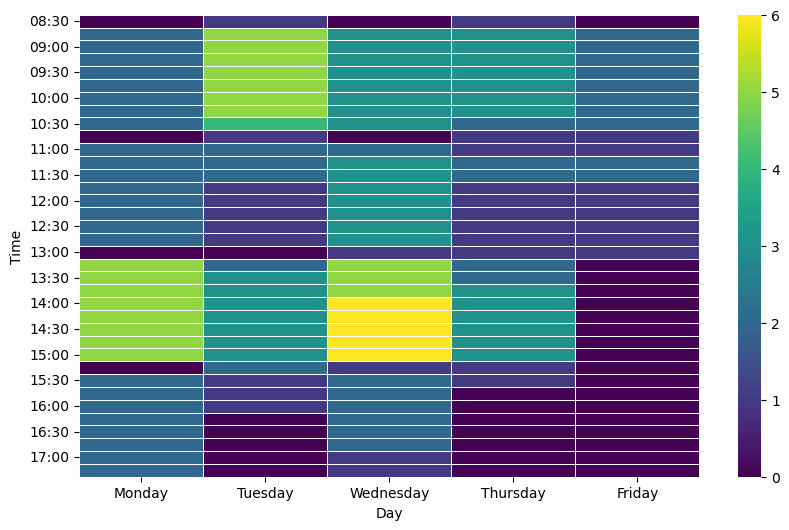

<Figure size 640x480 with 0 Axes>

In [102]:
# Convert times to a proper format for manipulation

import pandas as pd
def convert_to_minutes(time_str):
    """Convert HHMM time string to minutes since midnight"""
    if len(time_str) == 3:
        #e.g. 100
        time_str = "0"+time_str
    hours = int(time_str[:2])
    if hours < 8:
        hours += 12 #1 becomes 13 so 1pm sorts after 8am
    minutes = int(time_str[2:]) if len(time_str) > 2 else 0
    return hours * 60 + minutes

# Generate half-hour intervals and expand the DataFrame
def generate_half_hour_intervals(start_minutes, end_minutes):
    """Generate half-hour intervals between start and end times"""
    intervals = []
    current = start_minutes
    while current < end_minutes:
        intervals.append(current)
        current += 15  # increment by 30 minutes (half an hour)
    return intervals

# Function to expand shorthand dates into full days
def expand_days(short_days):
    days = []
    
    # Define mapping from shorthand to full day names
    day_mapping = {
        'M': 'Monday',
        'T': 'Tuesday',
        'W': 'Wednesday',
        'Th': 'Thursday',
        'F': 'Friday'
    }

    # Sort day_mapping by length of keys (longer keys first) to ensure proper matching
    sorted_day_mapping = dict(sorted(day_mapping.items(), key=lambda item: -len(item[0])))
    
    i = 0
    while i < len(short_days):
        # Check if current and next character form a valid shorthand (e.g., 'Th')
        if i + 1 < len(short_days) and short_days[i:i+2] in sorted_day_mapping:
            days.append(sorted_day_mapping[short_days[i:i+2]])
            i += 2
        elif short_days[i] in sorted_day_mapping:
            days.append(sorted_day_mapping[short_days[i]])
            i += 1
        else:
            # Handle any unexpected cases
            i += 1
    return days


def generate_schedule_heatmap(master_schedule,division="BBIO",year=2024,quarter="WIN"):
    "Generate a schedule heatmap for faculty from a master schedule"
    print(master_schedule.columns)
    master_schedule = master_schedule[master_schedule["Year"] == 2024]
    master_schedule = master_schedule[master_schedule["Quarter"] == "WIN"]
    master_schedule = master_schedule[master_schedule["Division"]=="BBIO"]
    df = master_schedule.loc[:,['Instructor','Meeting Times','Meeting Day']]

    df[['Start Time', 'End Time']] = df['Meeting Times'].str.split('-', expand=True)

    

    df['Start Minutes'] = df['Start Time'].apply(convert_to_minutes)
    df['End Minutes'] = df['End Time'].apply(convert_to_minutes)
    
    # Create a new DataFrame to hold the expanded entries
    expanded_rows = []
    for _, row in df.iterrows():
        intervals = generate_half_hour_intervals(row['Start Minutes'], row['End Minutes'])
        for interval in intervals:
            # Convert minutes back to HHMM format
            hour = interval // 60
            minute = interval % 60
            time_str = f"{hour:02d}{minute:02d}"
            expanded_rows.append({
                'Instructor': row['Instructor'],
                'Meeting Time': time_str,
                'Day': row['Meeting Day']
            })
    
    expanded_df = pd.DataFrame(expanded_rows)

    # Print the expanded DataFrame
    print(expanded_df['Day'].unique())
    expanded_df

    # Define mapping from shorthand to full day names
    day_mapping = {
        'M': 'Monday',
        'T': 'Tuesday',
        'W': 'Wednesday',
        'Th': 'Thursday',
        'F': 'Friday'
    }

    # Sort day_mapping by length of keys (longer keys first) to ensure proper matching
    sorted_day_mapping = dict(sorted(day_mapping.items(), key=lambda item: -len(item[0])))

    # Expand the shorthand dates into full days and create a new DataFrame
    expanded_entries = []
    for _, row in expanded_df.iterrows():
        days = expand_days(row['Day'])
        for day in days:
            expanded_entries.append({
                'Instructor': row['Instructor'],
                'Time': row['Meeting Time'],
                'Day': day
            })

    expanded_df = pd.DataFrame(expanded_entries)
    expanded_df["Time"]=pd.to_numeric(expanded_df["Time"])

    # Print the expanded DataFrame
    print(expanded_df)
    
    counts = expanded_df.groupby(['Time', 'Day']).size().reset_index(name='Instructor Count')

    # Pivot the DataFrame
    pivot_table = counts.pivot_table(index='Time', columns='Day', values='Instructor Count',fill_value=0)

    # Define the custom order for days of the week
    day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']

    # Reorder columns based on the custom order
    pivot_table = pivot_table[day_order]

    # Sort rows by times (index), assuming index is in HHMM format
    pivot_table.index = pd.to_datetime(pivot_table.index, format='%H%M').strftime('%H:%M')
    pivot_table = pivot_table.sort_index()

    import seaborn as sns
    import matplotlib.pyplot as plt
    %matplotlib inline
    # Create a heatmap
    plt.figure(figsize=(10, 6))
    sns.heatmap(pivot_table, cmap='viridis', linewidths=.5)
    plt.show()
    plt.savefig(f"schedule_heatmap_{division}_{year}_{quarter}.png")    
    pivot_table.to_csv(f"schedule_time_counts_{division}_{year}_{quarter}.csv")
    expanded_df.to_csv(f"expanded_schedule_by_instructor_{division}_{year}_{quarter}.csv")
    
generate_schedule_heatmap(master_schedule)